Jonathan Sosa Uranga<br><br>
analysisTest.ipynb
<br><br>
Peak Performance Data Analysis for Seasonal Performance

In [ ]:
#imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from datetime import datetime, timedelta
from matplotlib import dates as mpl_dates
from analysis import An

# Automatically reload external modules
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
#loads the data set into a pandas dataframe
data = pd.read_csv('data/WS.csv')

#filters the columns to the ones we are going to use
filterData = data[['Date', 'Name', 'Position', 'System Weight', 'Jump Height', 'L|R Avg. Braking RFD','Time To Takeoff','mRSI', 'Peak Relative Propulsive Power']]

#tested filter data
print (filterData)

            Date            Name Position  System Weight  Jump Height  \
0     09/28/2022  Abby Thorndike     Back       693.1050       0.1882   
1     09/28/2022  Abby Thorndike     Back       692.1250       0.1963   
2     09/28/2022  Abby Thorndike     Back       694.2870       0.2047   
3     09/19/2022  Abby Thorndike     Back       686.3470       0.1788   
4     09/19/2022  Abby Thorndike     Back       688.0070       0.1692   
...          ...             ...      ...            ...          ...   
5182  10/06/2021  Taylor Douglas      NaN       625.4494       0.2256   
5183  09/23/2021  Taylor Douglas      NaN       630.3964       0.2769   
5184  08/25/2021  Taylor Douglas      NaN       636.4935       0.2144   
5185  08/25/2021  Taylor Douglas      NaN       634.8999       0.2418   
5186  08/25/2021  Taylor Douglas      NaN       638.9339       0.2184   

      L|R Avg. Braking RFD  Time To Takeoff    mRSI  \
0                  -3.0992            0.747  0.2520   
1            

In [ ]:
#test descriptive statistics
print(filterData.describe())

       System Weight  Jump Height  L|R Avg. Braking RFD  Time To Takeoff  \
count    5187.000000  5187.000000           5160.000000      5187.000000   
mean      626.730972     0.245567              0.905623         0.772362   
std        64.543074     0.046602             15.753939         0.165474   
min       459.237000     0.000000           -100.000000         0.000000   
25%       578.468250     0.215600             -7.620075         0.660000   
50%       619.589600     0.247700              0.791150         0.759000   
75%       677.013500     0.278400              8.617375         0.869000   
max       815.745500     0.419400            102.803700         4.625000   

              mRSI  Peak Relative Propulsive Power  
count  5186.000000                     5186.000000  
mean      0.331426                       41.368419  
std       0.087533                        5.976354  
min       0.000000                        3.144900  
25%       0.275900                       37.780325

In [56]:
#test groupby function

#groups by athlete
grpAthlete = filterData.groupby('Name')

#iterates in the group
for name, group in grpAthlete:
    print(name)
    print(group.describe())
    print()


Abby Thorndike
       System Weight  Jump Height  L|R Avg. Braking RFD  Time To Takeoff  \
count      99.000000    99.000000             99.000000        99.000000   
mean      652.008507     0.199739             -1.062982         0.596687   
std        21.251890     0.022560             13.515742         0.098672   
min       616.371600     0.133600            -42.926800         0.424000   
25%       635.372400     0.185100             -9.401900         0.525500   
50%       653.181200     0.199900              0.202500         0.581000   
75%       662.551050     0.218700              9.213000         0.639500   
max       697.385000     0.237400             33.692000         0.935000   

            mRSI  Peak Relative Propulsive Power  
count  99.000000                       99.000000  
mean    0.340748                       41.036027  
std     0.050932                        2.795547  
min     0.211400                       34.334100  
25%     0.309950                       38.977

In [57]:
#filters by date

# Convert the date to datetime64
filterData['Date'] = pd.to_datetime(filterData['Date'], format='%m/%d/%Y')

# Filter data for fall
fall21Data = filterData.loc[(filterData['Date'] >= '08/01/2021') & (filterData['Date'] < '10/01/2021')]
print('Mean:')
print(fall21Data.mean())
print('--------------------')
print('Standard Deviation:')
print(fall21Data.std())

Mean:
System Weight                     609.162347
Jump Height                         0.253990
L|R Avg. Braking RFD                2.515816
Time To Takeoff                     0.723312
mRSI                                0.361051
Peak Relative Propulsive Power     43.082982
dtype: float64
--------------------
Standard Deviation:
Date                              15 days 15:35:32.796593302
System Weight                                      61.817038
Jump Height                                          0.04059
L|R Avg. Braking RFD                               11.257841
Time To Takeoff                                     0.130339
mRSI                                                0.079404
Peak Relative Propulsive Power                      5.511874
dtype: object


/var/folders/6r/6kwn1zm53m107ycbq5f_9wm40000gn/T/ipykernel_42601/2818352296.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filterData['Date'] = pd.to_datetime(filterData['Date'], format='%m/%d/%Y')
/var/folders/6r/6kwn1zm53m107ycbq5f_9wm40000gn/T/ipykernel_42601/2818352296.py:9: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  print(fall21Data.mean())
/var/folders/6r/6kwn1zm53m107ycbq5f_9wm40000gn/T/ipykernel_42601/2818352296.py:9: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or s

In [58]:
#test the analysis object
aObj = An('data/WS.csv',2021,fall='08/26',winter='10/15',spring='2/1',summer='05/26')
aObj.initialize()
#print(aObj.mean)
ds=aObj.fData

print (ds)

           Date               Name  System Weight  Jump Height  Braking RFD  \
5183 2021-09-23     Taylor Douglas       630.3964       0.2769    4638.2979   
3807 2021-09-23    Melanie Chernin       473.5646       0.2620    4066.6667   
4197 2021-09-23  Michaela Cosgriff       668.6356       0.3066    7485.5072   
380  2021-09-23      Aoife Kennedy       615.5506       0.2692    3050.6912   
3647 2021-09-23     Maxine Jamison       563.4575       0.2463    5941.1765   
...         ...                ...            ...          ...          ...   
1851 2022-05-11  Jackie Portogallo       635.7648       0.2809    4467.4556   
1852 2022-05-11  Jackie Portogallo       636.7828       0.2769    5397.1631   
1696 2022-05-11     Emily McMaster       627.6166       0.2977    4355.1913   
1694 2022-05-11     Emily McMaster       627.6567       0.3101    4528.0899   
1695 2022-05-11     Emily McMaster       625.6727       0.3018    4284.2105   

      Time To Takeoff    mRSI  
5183            0.7

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:214: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  self.mean = self.fData.mean()
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:214: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  self.mean = self.fData.mean()
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:215: FutureWarning: The default value of numeric_only in DataFrame.std is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  self.std = self.fData.std()


KeyError: 'L|R Avg. Braking RFD'

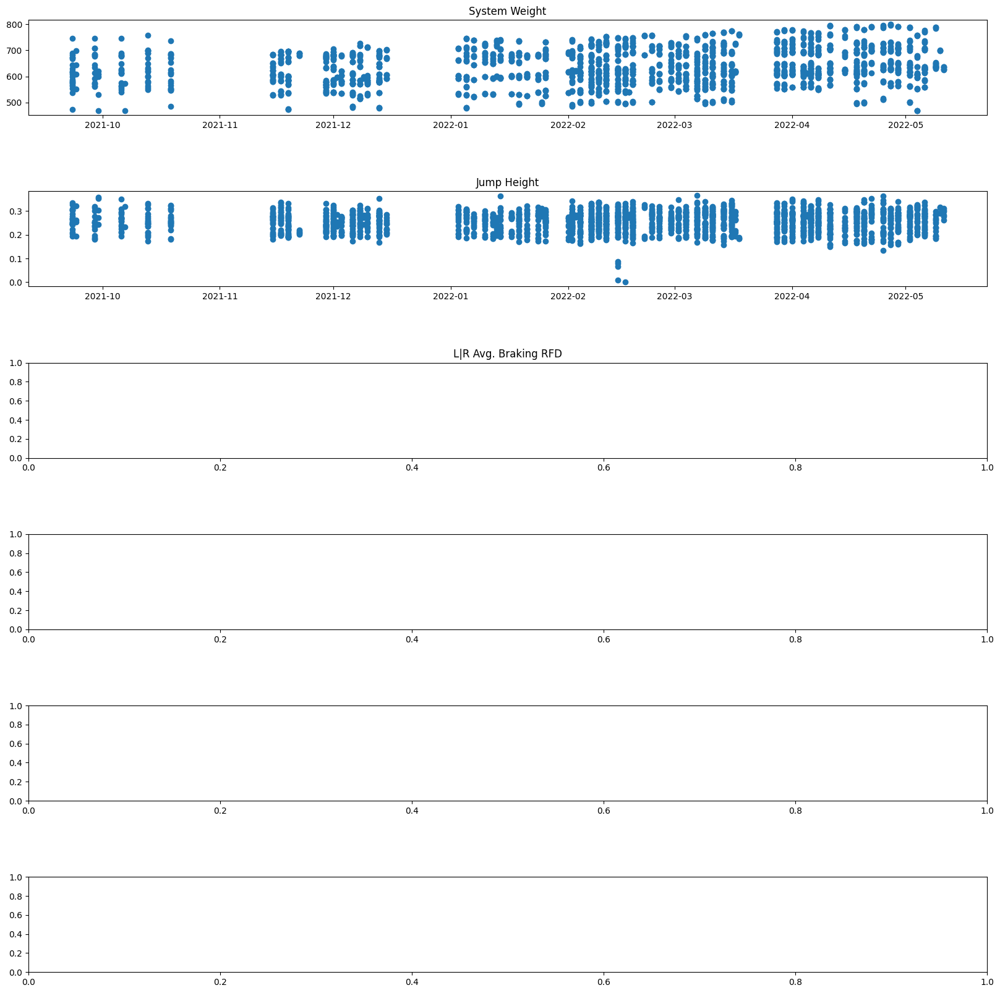

In [59]:
#tests the scatter plot

dates = ds.loc[:,'Date']
variables = ['System Weight', 'Jump Height', 'L|R Avg. Braking RFD','Time To Takeoff','mRSI', 'Peak Relative Propulsive Power']

#subplots
fig, axs = plt.subplots(len(variables), 1, figsize=(20, 20))
plt.subplots_adjust(hspace=0.8)

#for loop
for i in range(len(variables)):
    axs[i].set_title(variables[i])
    axs[i].scatter(dates,ds.loc[:,variables[i]])

#graph configuration
plt.suptitle("Team Statistics", fontsize=20, y=1)
plt.gcf().autofmt_xdate()
fig.tight_layout()
plt.show()

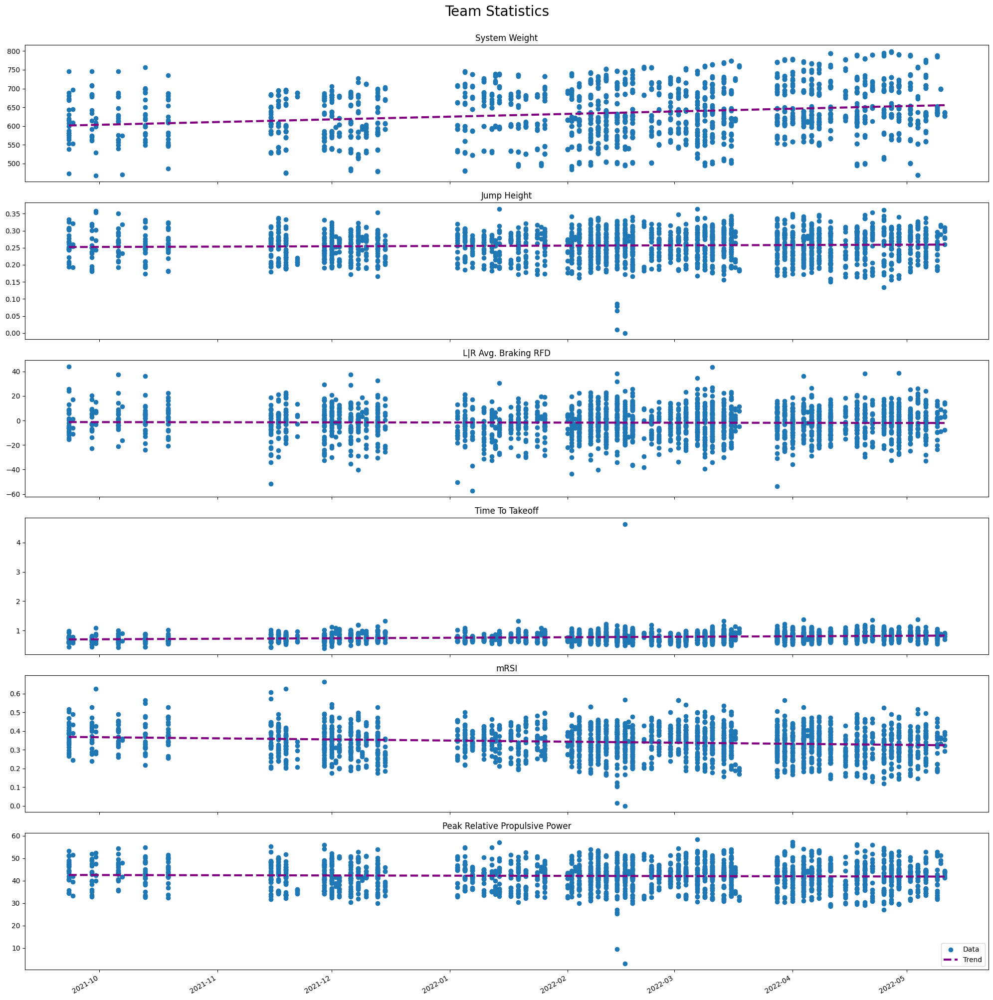

In [ ]:
#tests the scatter plot with the regression

dates = ds.loc[:,'Date']

#subplots
fig, axs = plt.subplots(len(variables), 1, figsize=(20, 20))
plt.subplots_adjust(hspace=0.8)

for i in range(len(variables)):

    #scatterplot
    axs[i].set_title(variables[i])
    axs[i].scatter(dates,ds.loc[:,variables[i]])

    #linear regression
    s = ds.set_index('Date')[variables[i]]

    y = s
    x = (s.index - pd.Timestamp(0)).days.values
    
    #calculate equation for trendline
    z = np.polyfit(x, y, 1)
    p = np.poly1d(z)

    #add trendline to plot
    axs[i].plot(dates, p(x), color="purple", linewidth=3, linestyle="--")

#graph configuration
plt.suptitle("Team Statistics", fontsize=20, y=1)
plt.legend(["Data", "Trend"], loc ="lower right")
plt.gcf().autofmt_xdate()
fig.tight_layout()
plt.show()


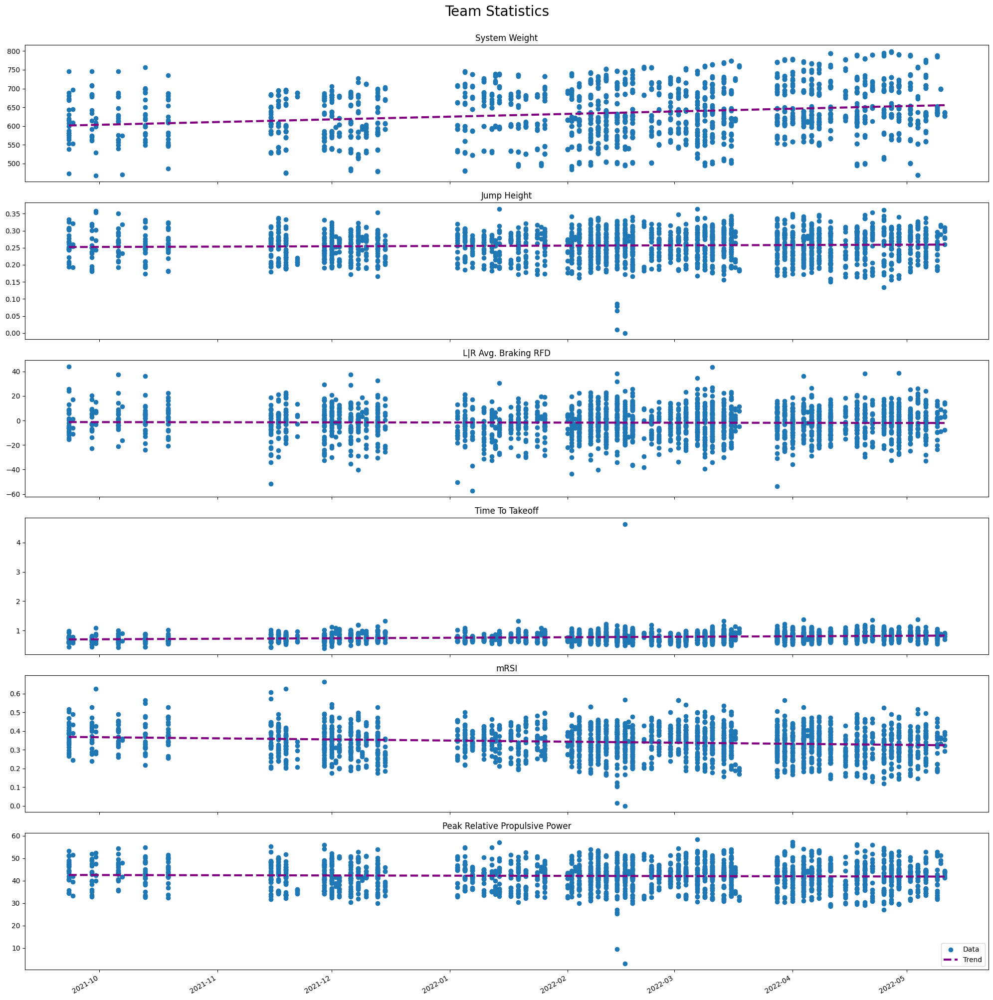

In [ ]:
#test Object
#aObj = analysis object
#ds = filtered data

#the expected output is the same of above

aObj.varGraphs(ds, 'Team Statistics')

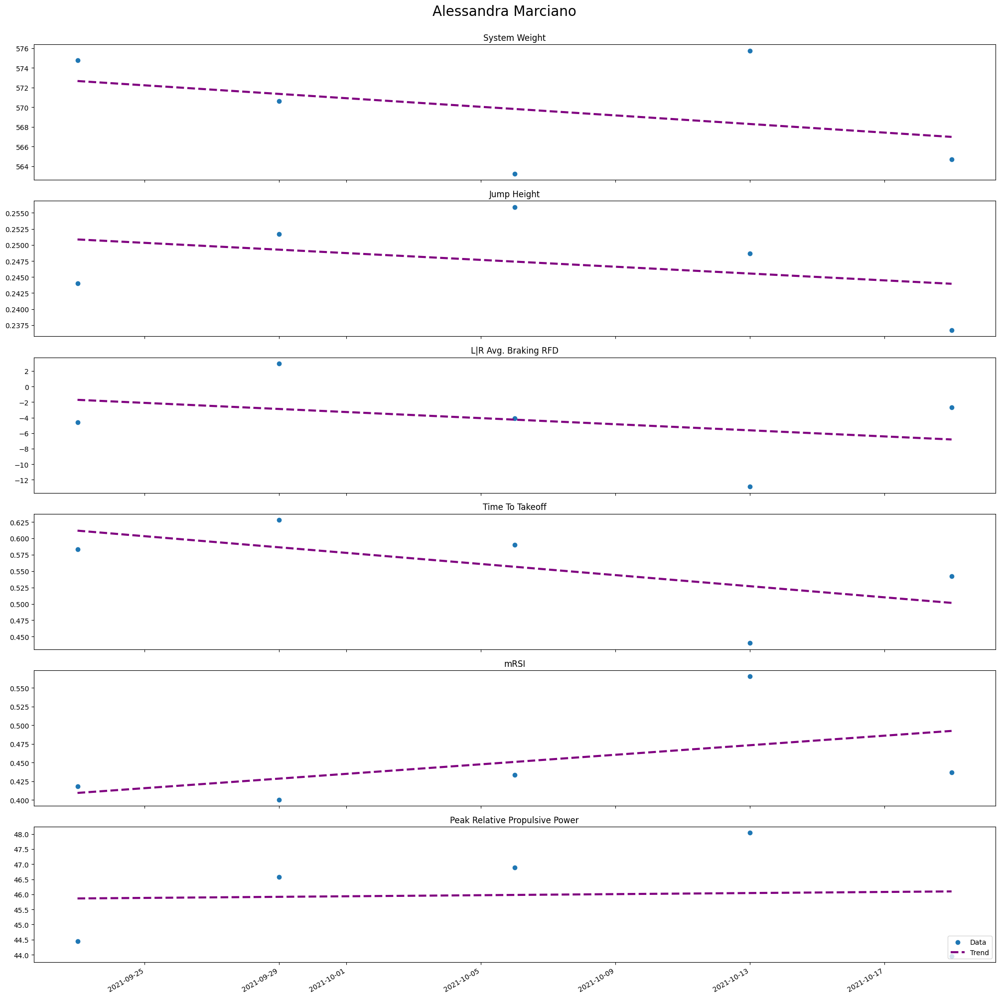

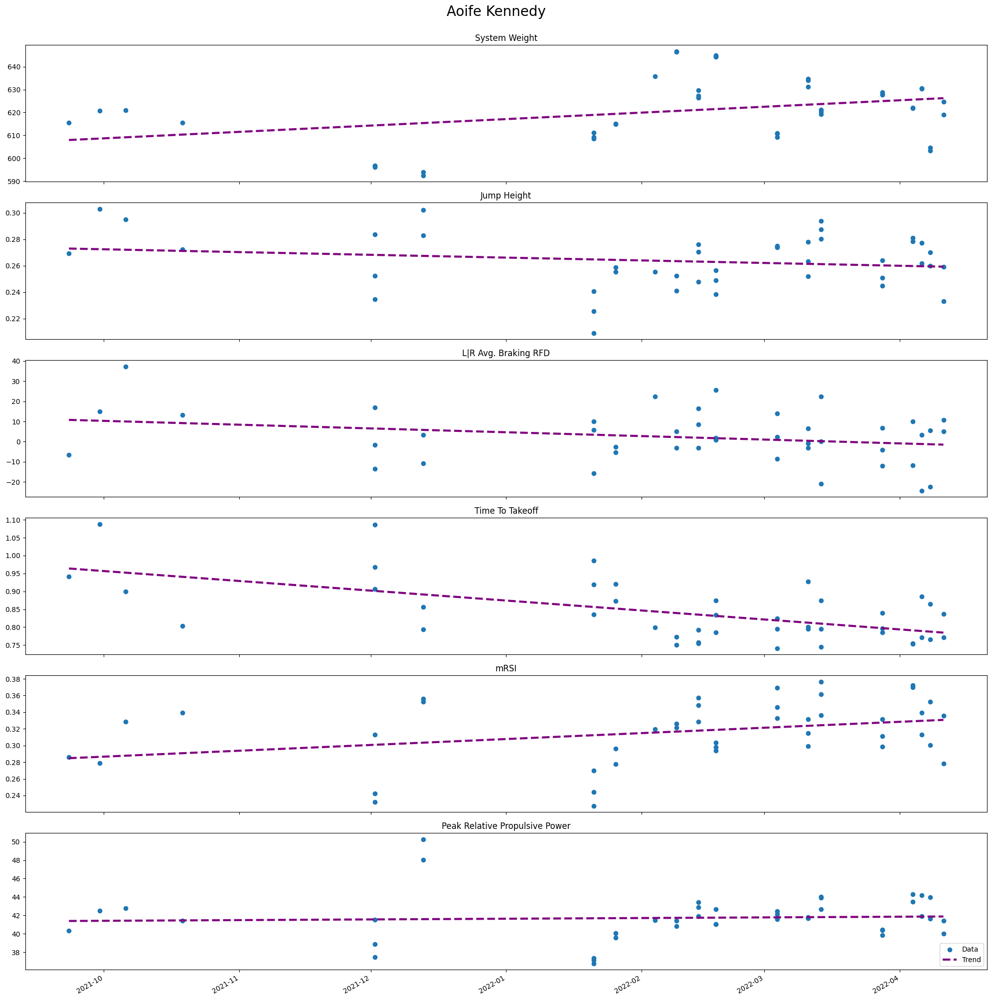

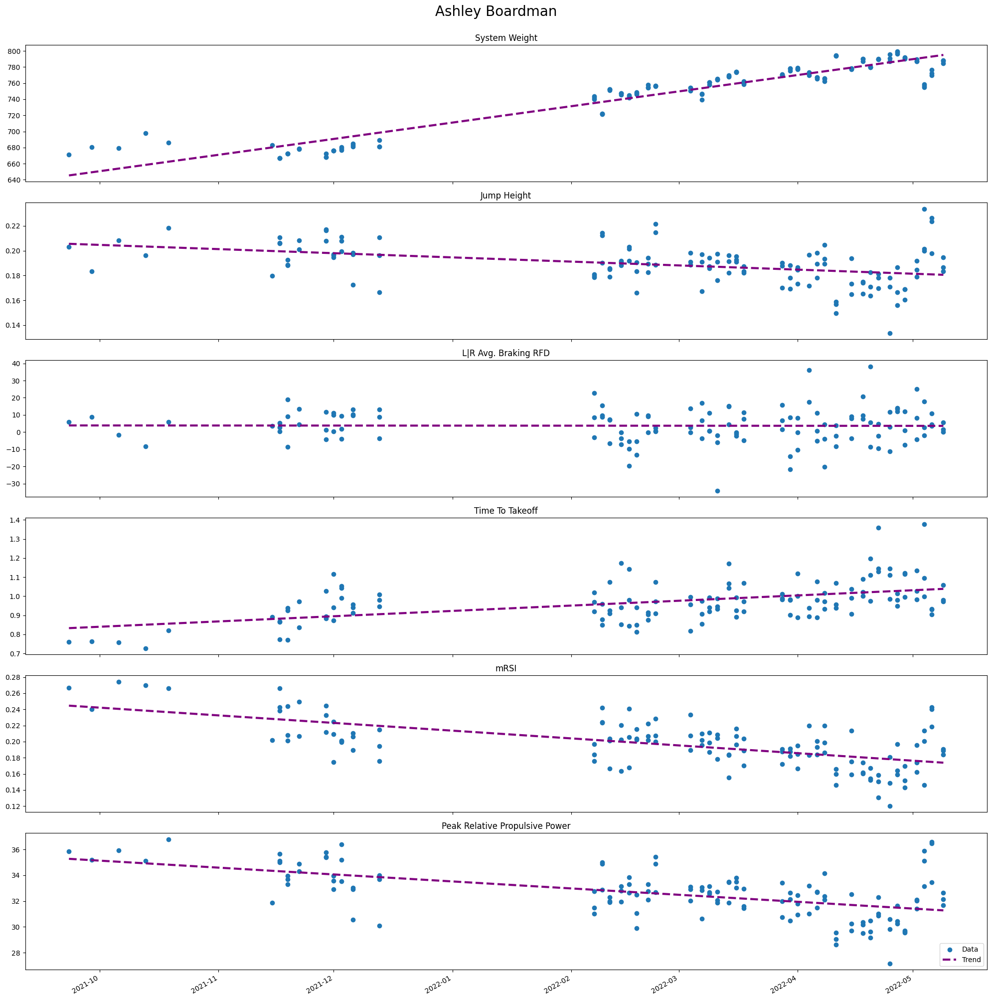

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


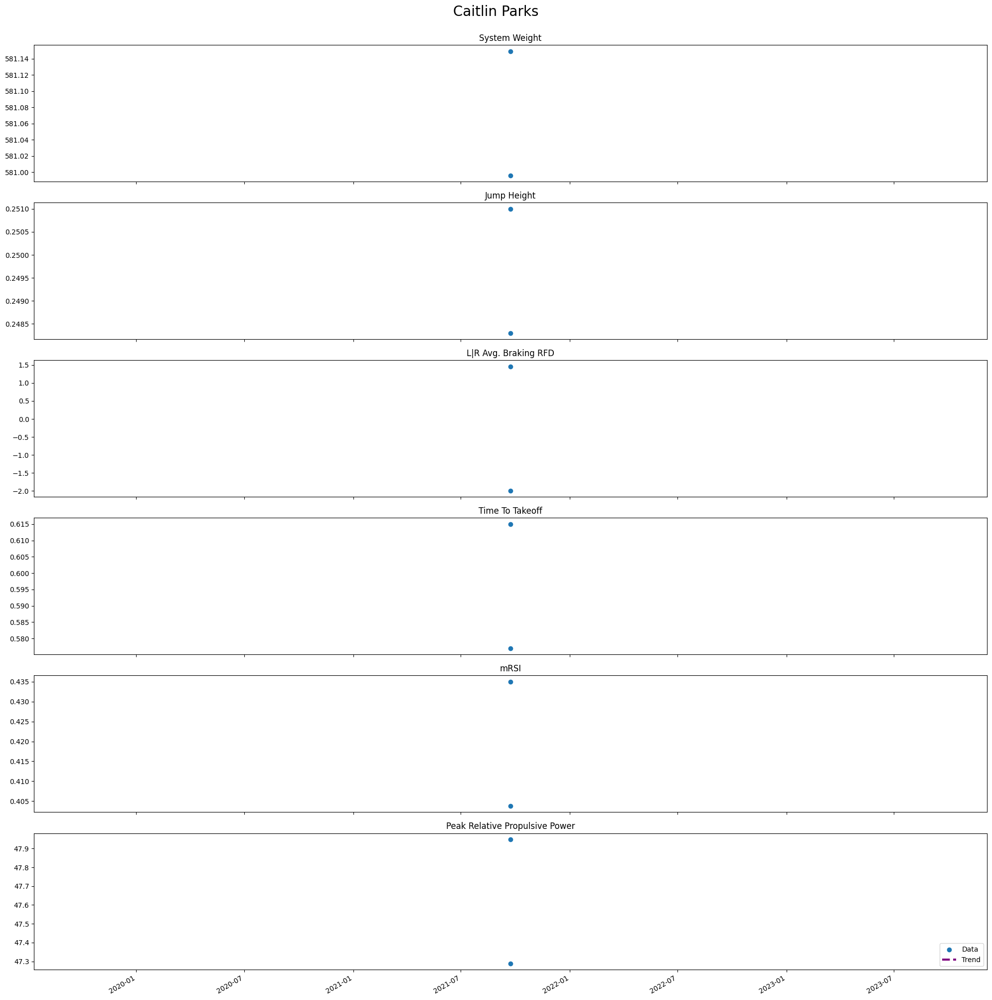

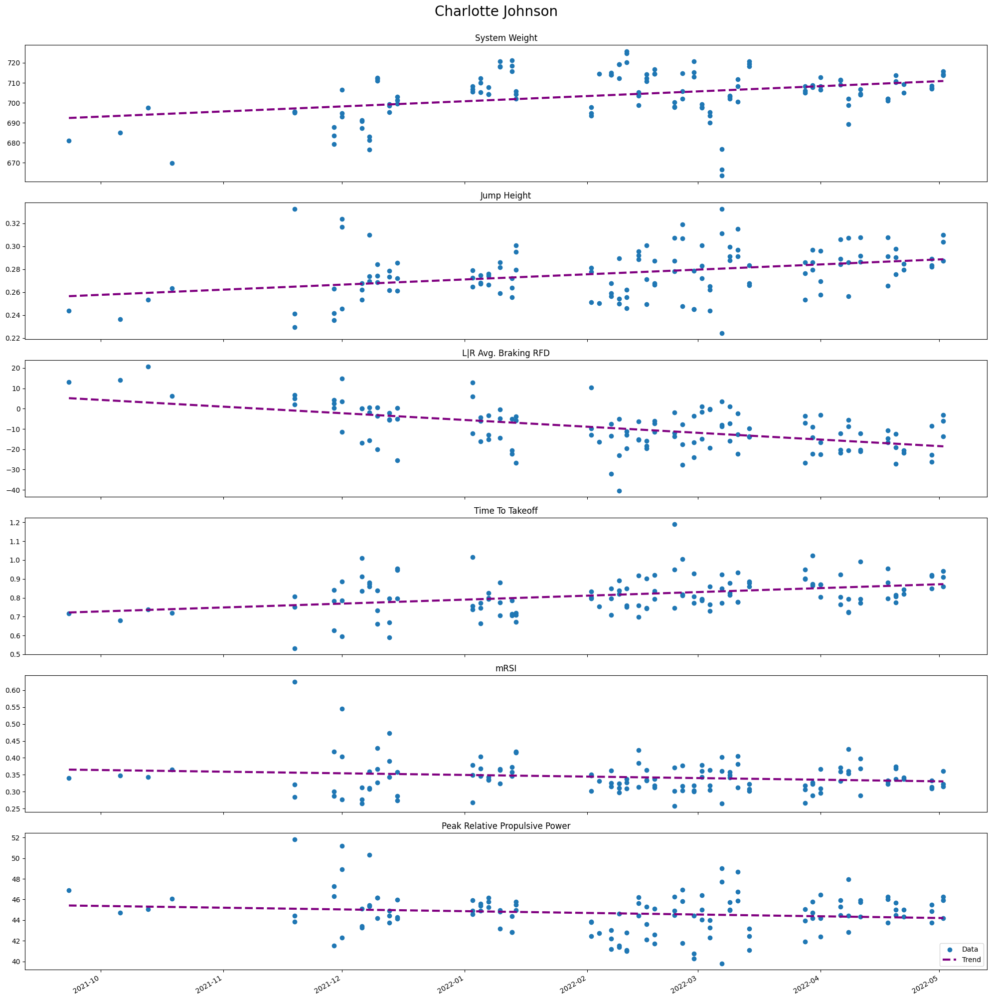

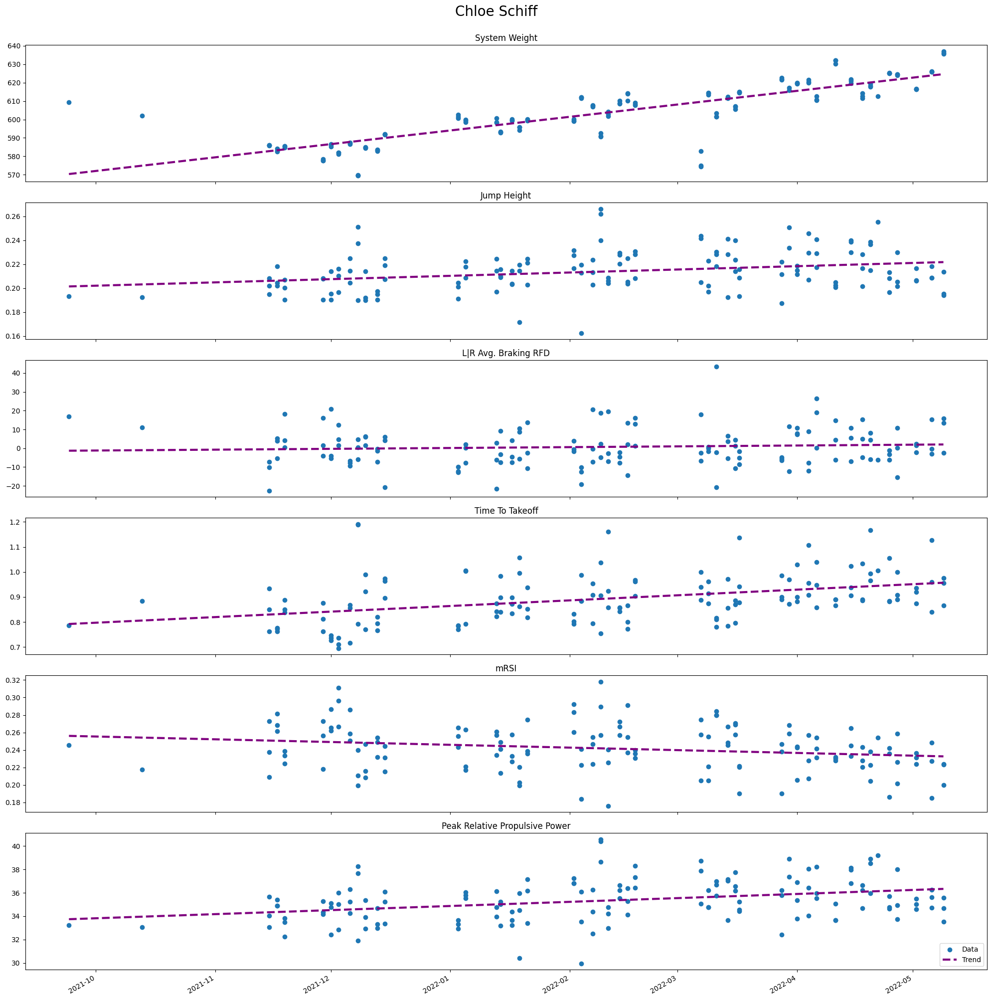

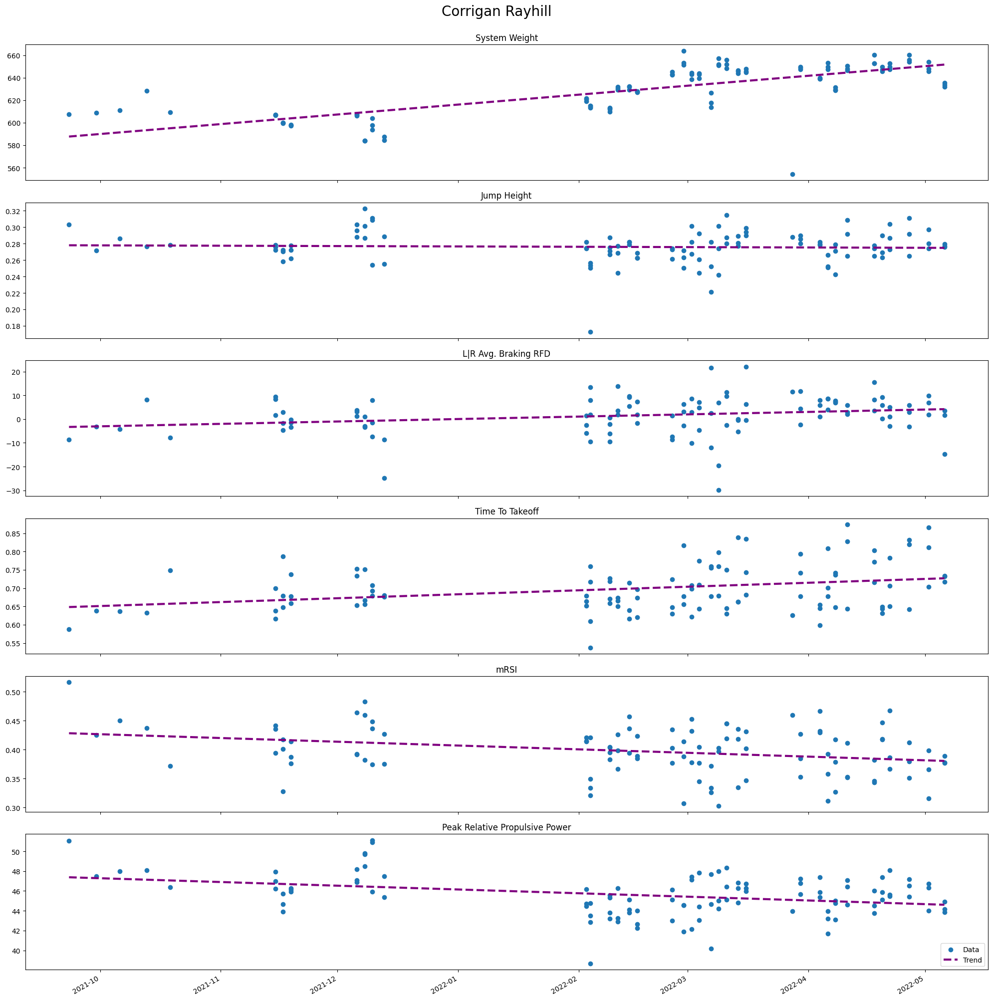

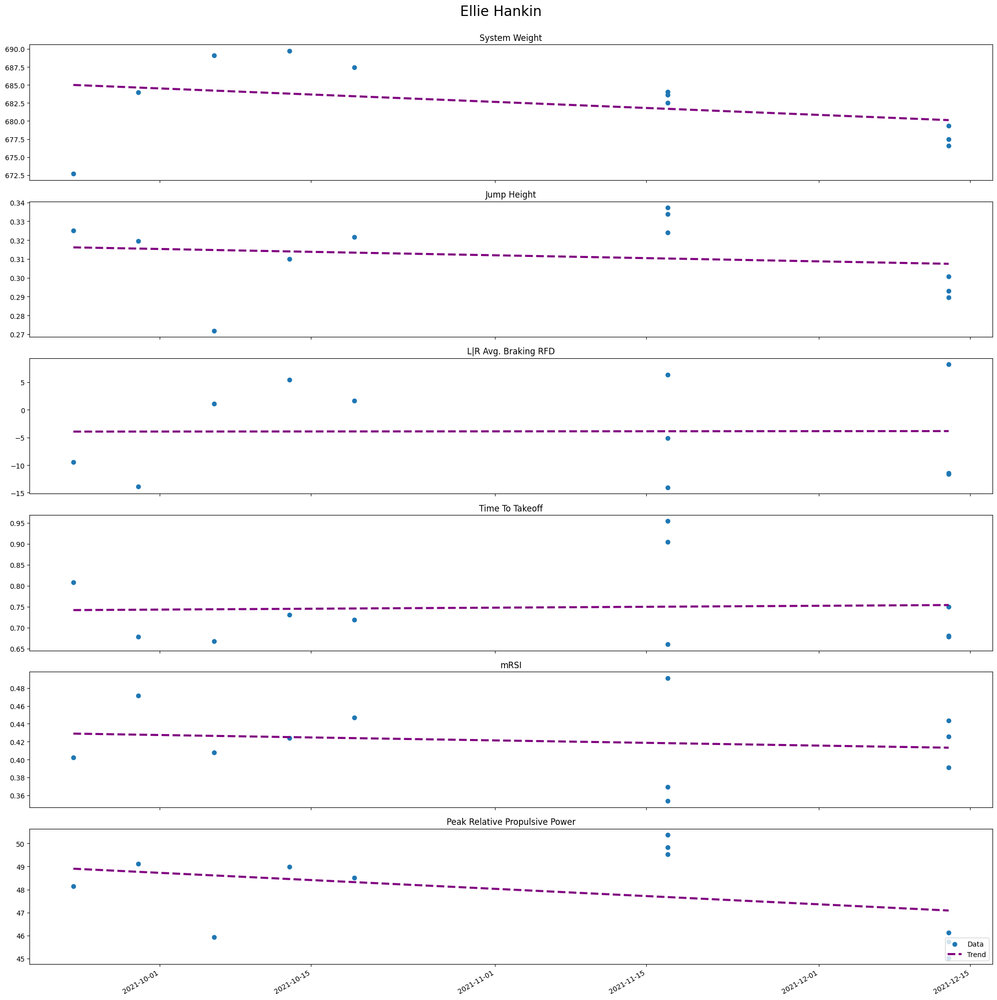

...

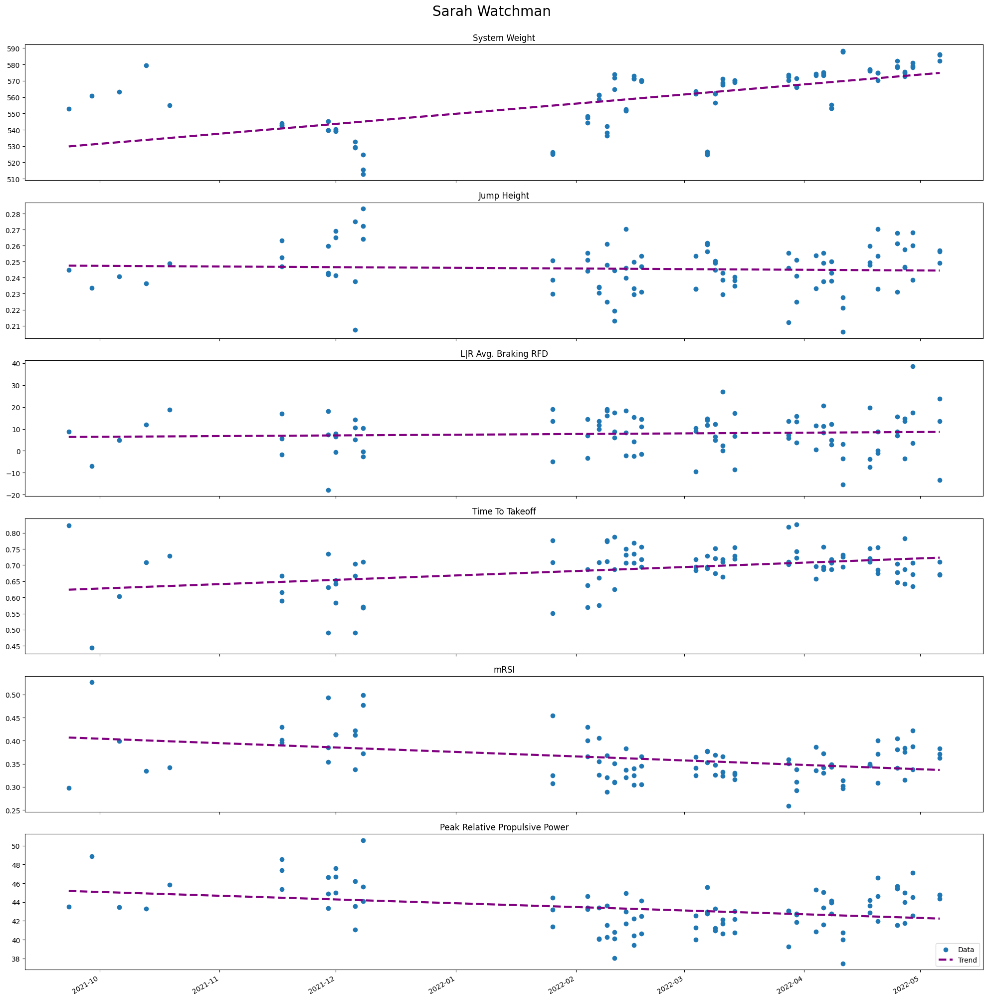

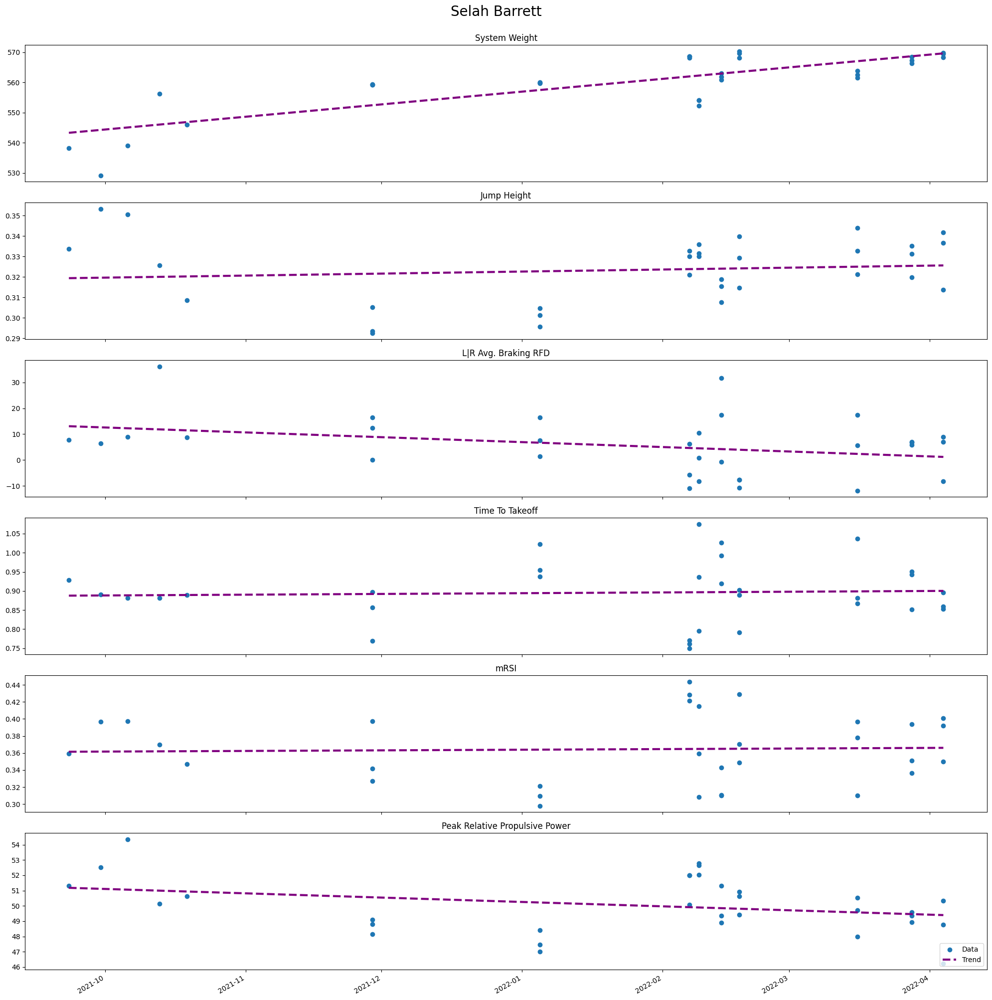

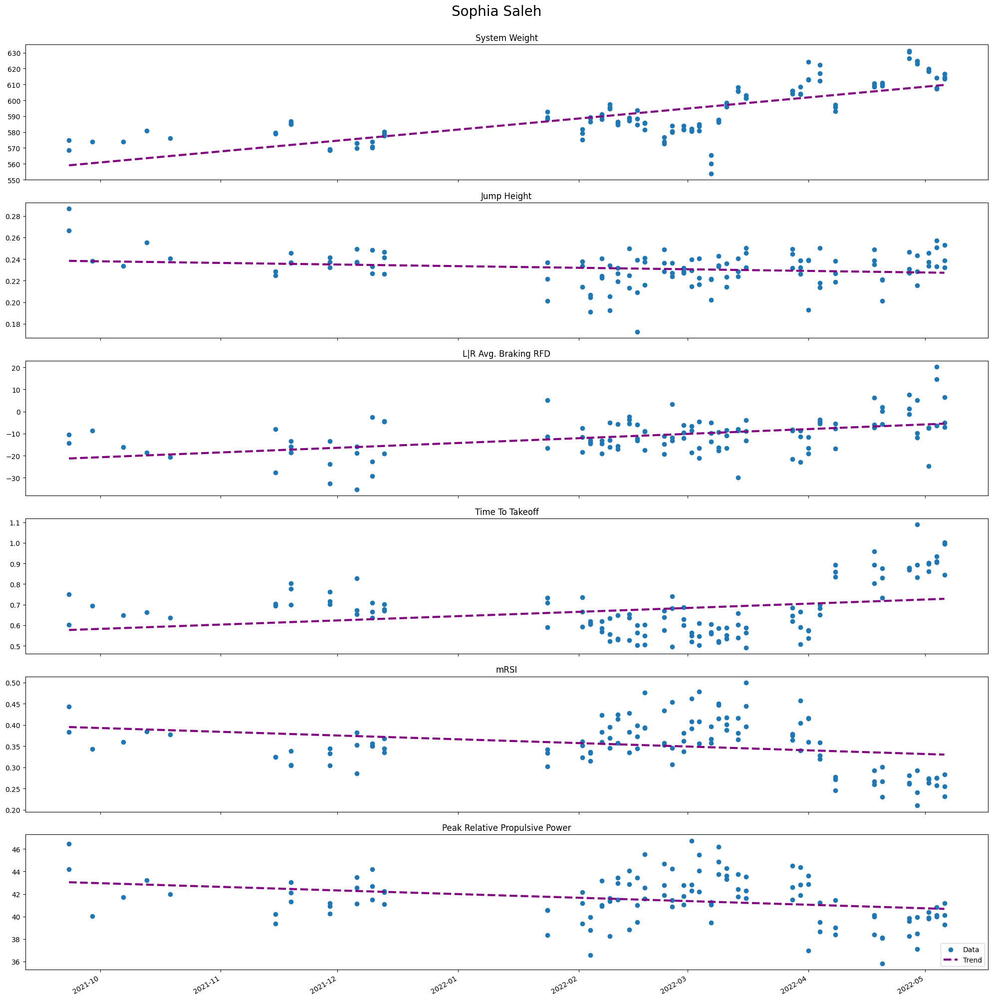

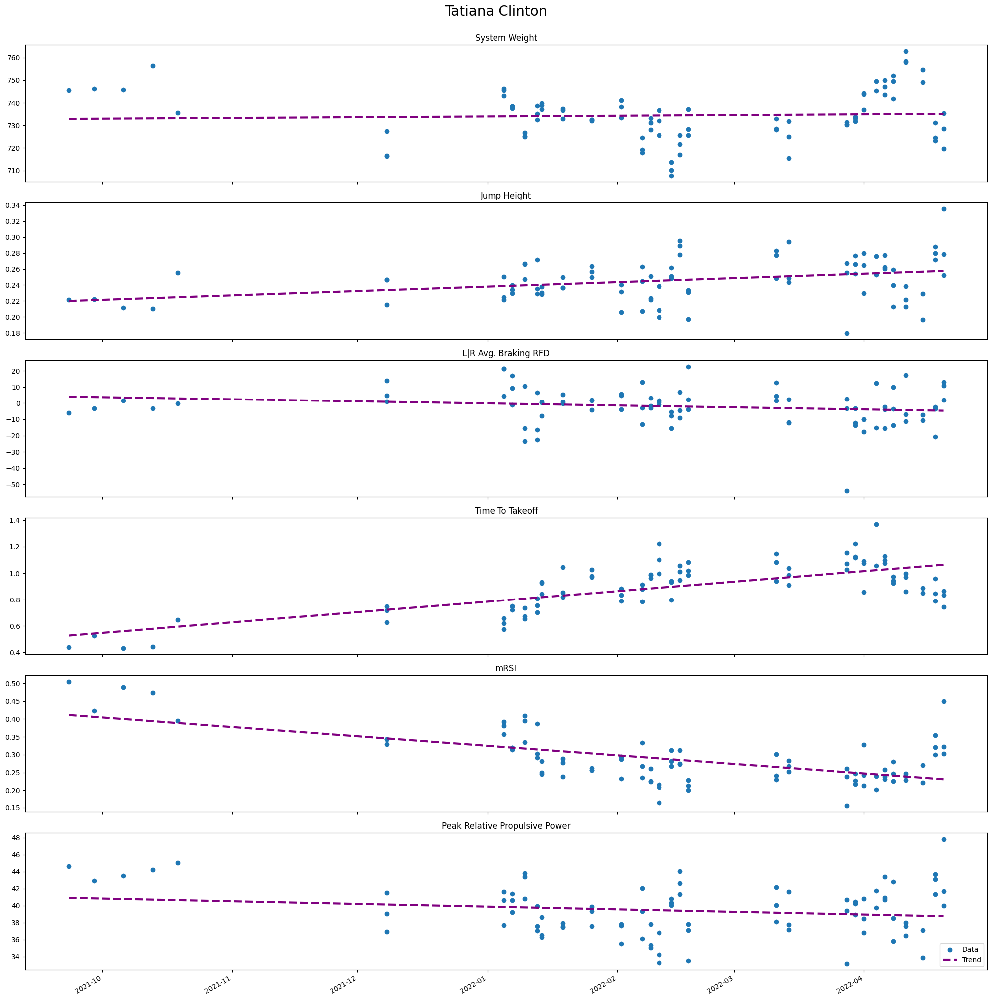

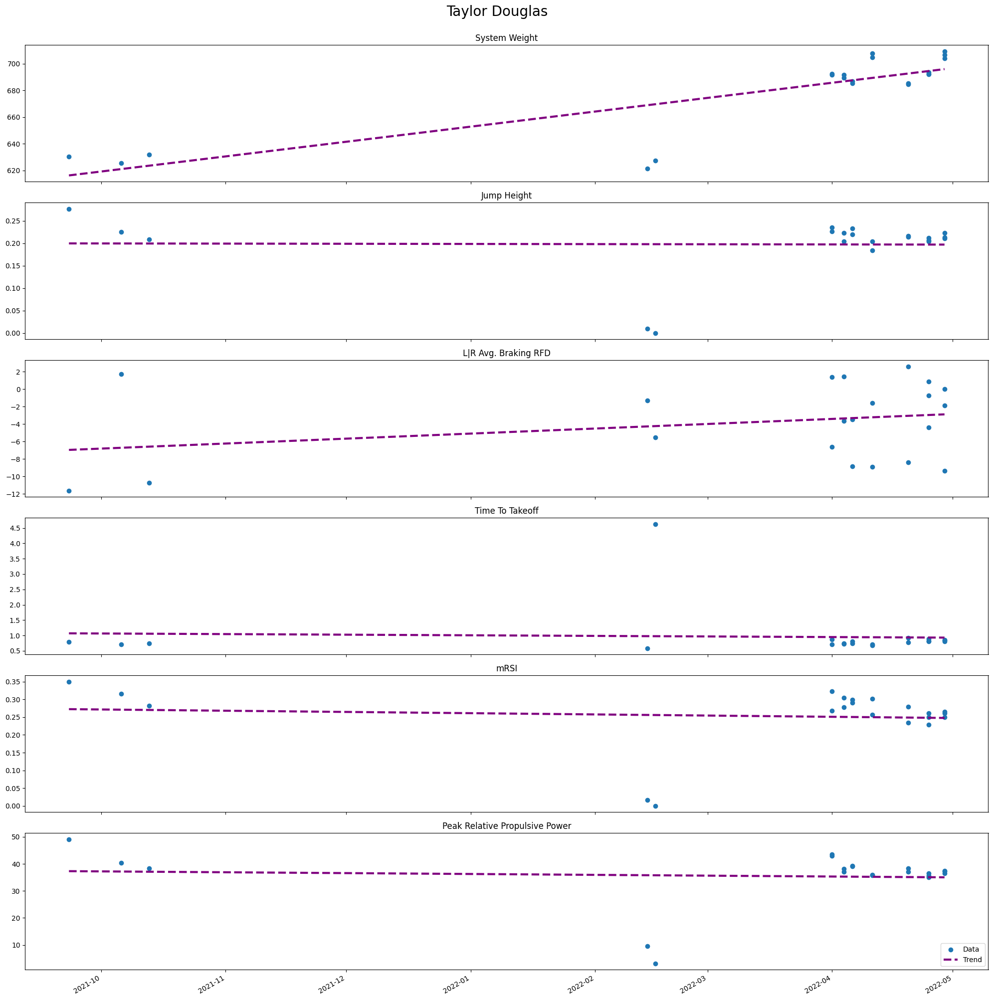

In [ ]:
#test graphs for individuals

grp = aObj.grpAthl(ds)

#aObj.varGraphsInd('Abby Thorndike')

#iterates in the group
for name,group in grp:
    aObj.varGraphsInd(name)


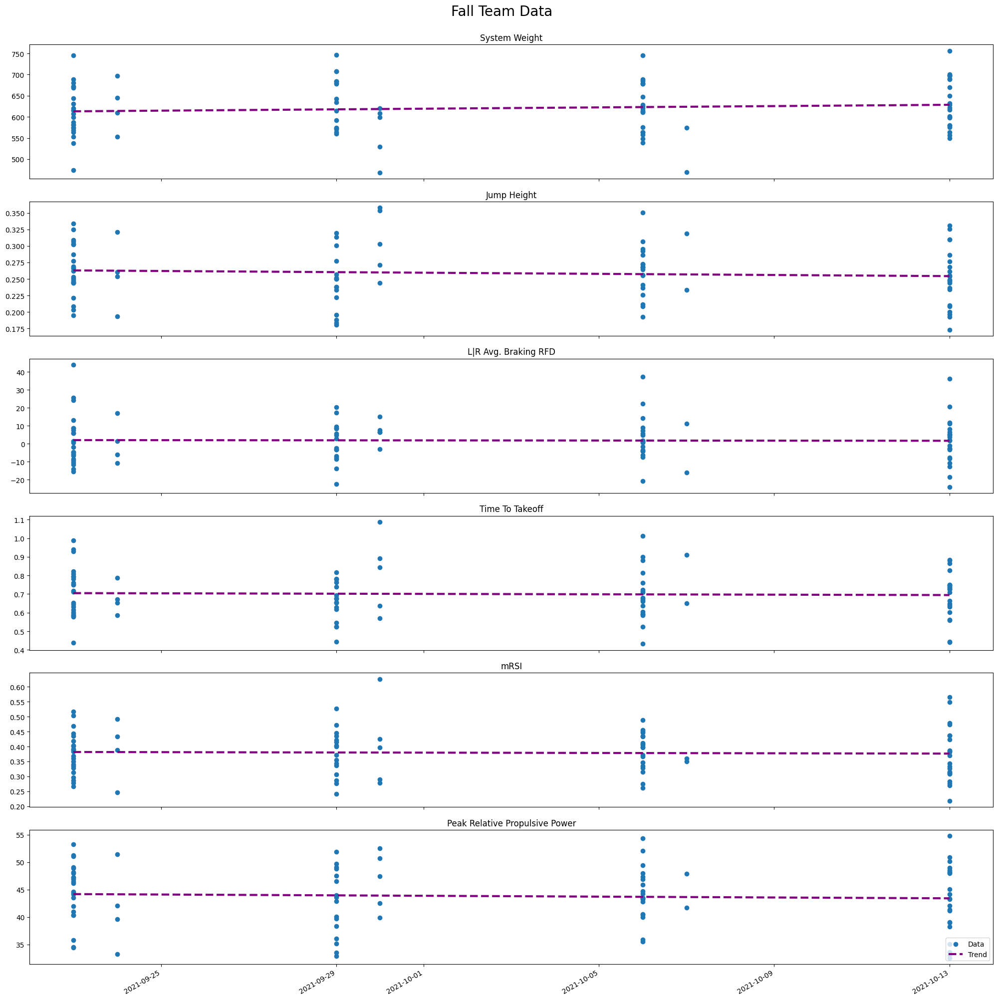

In [ ]:
#test for fall data graph 
aObj.fallGraphs()

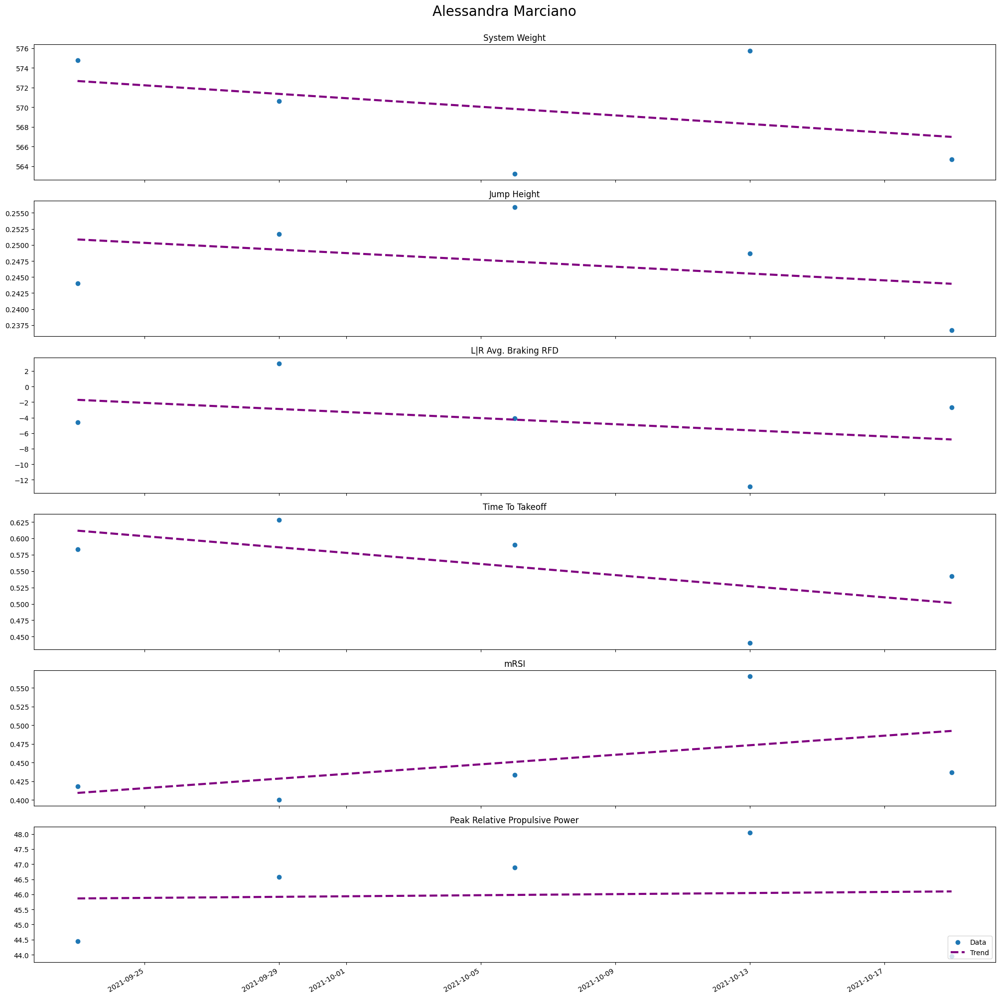

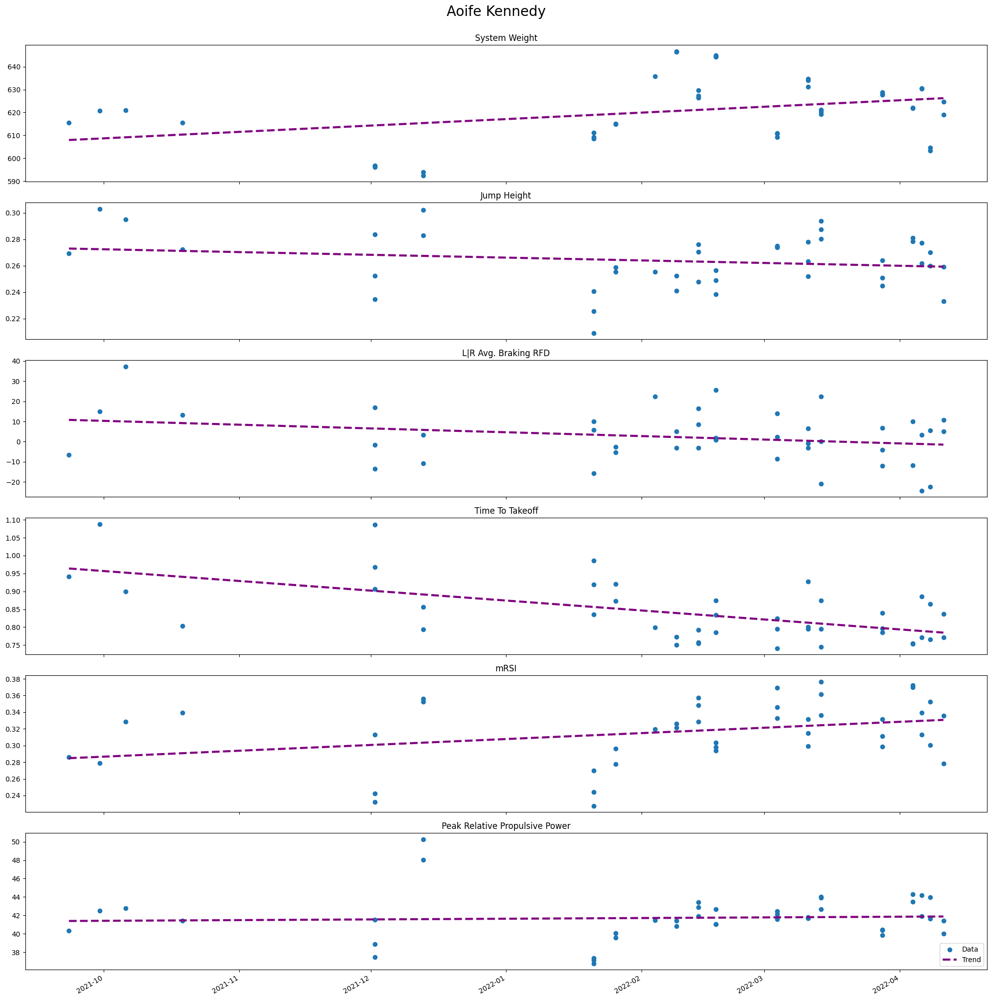

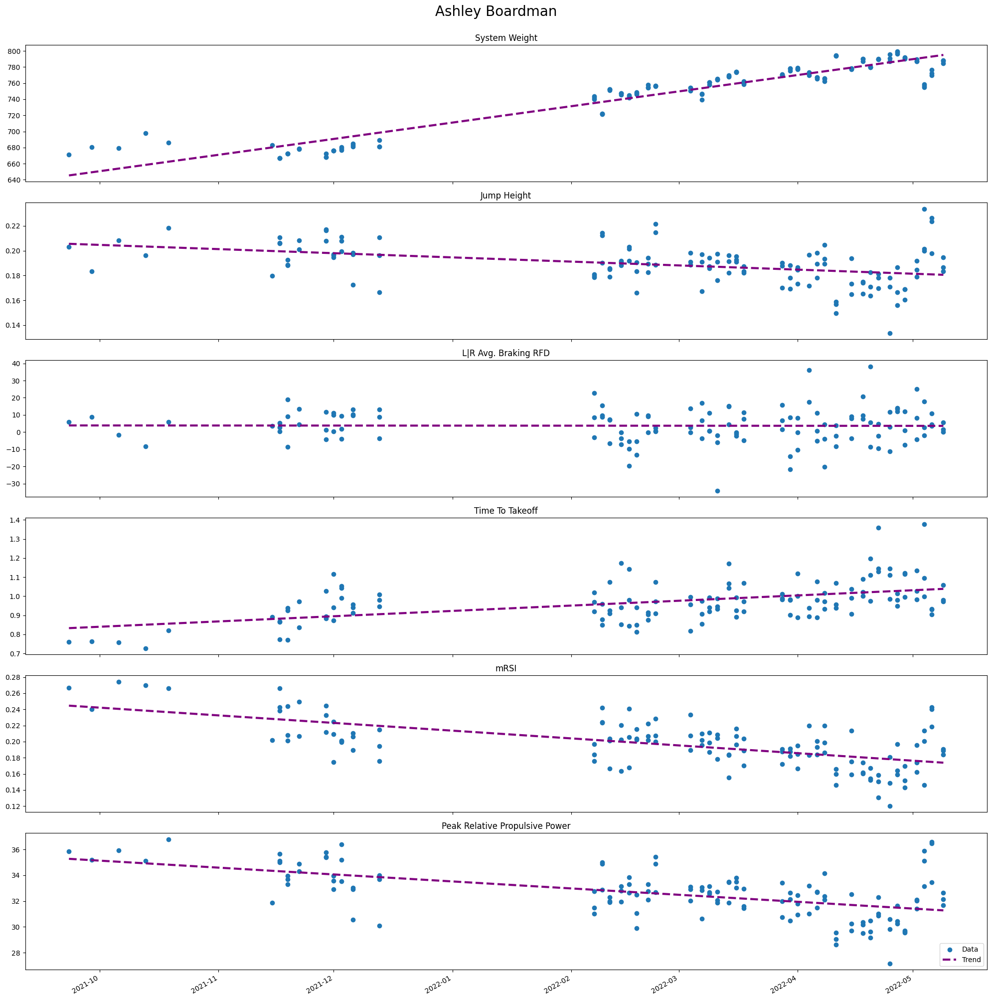

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


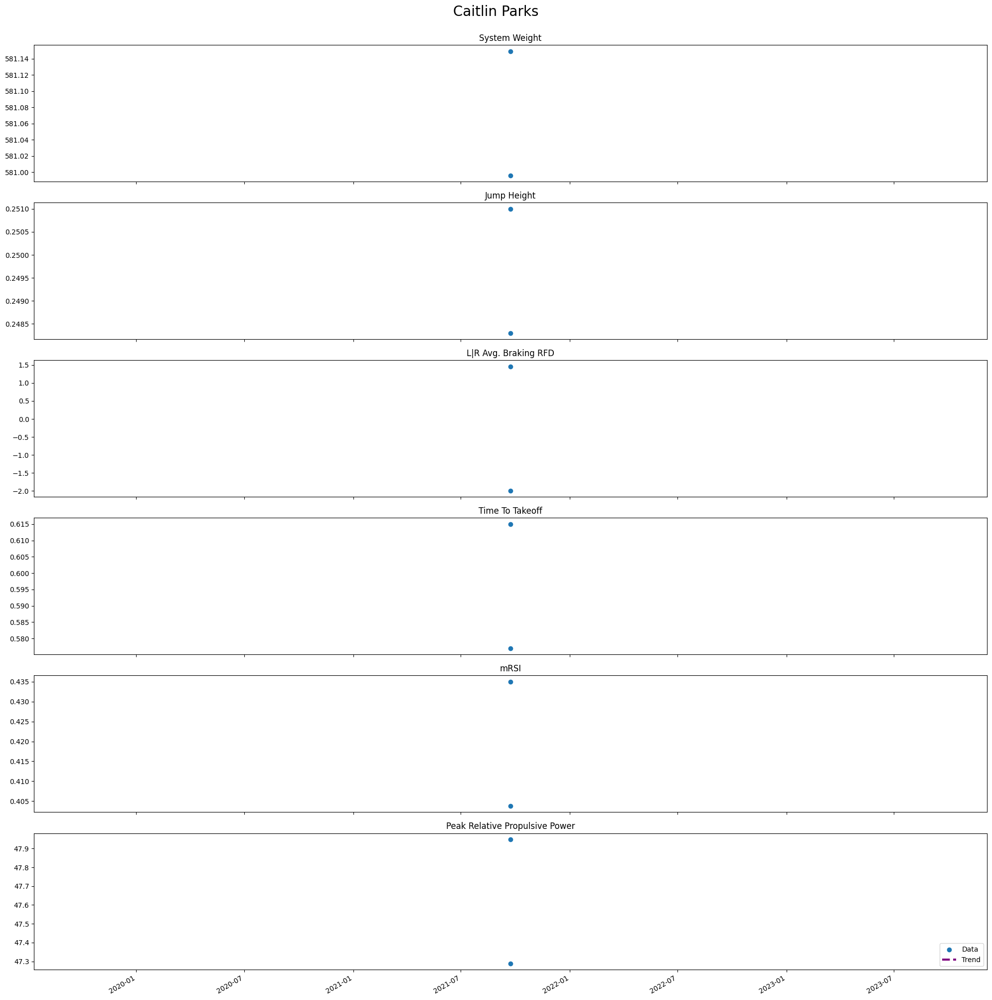

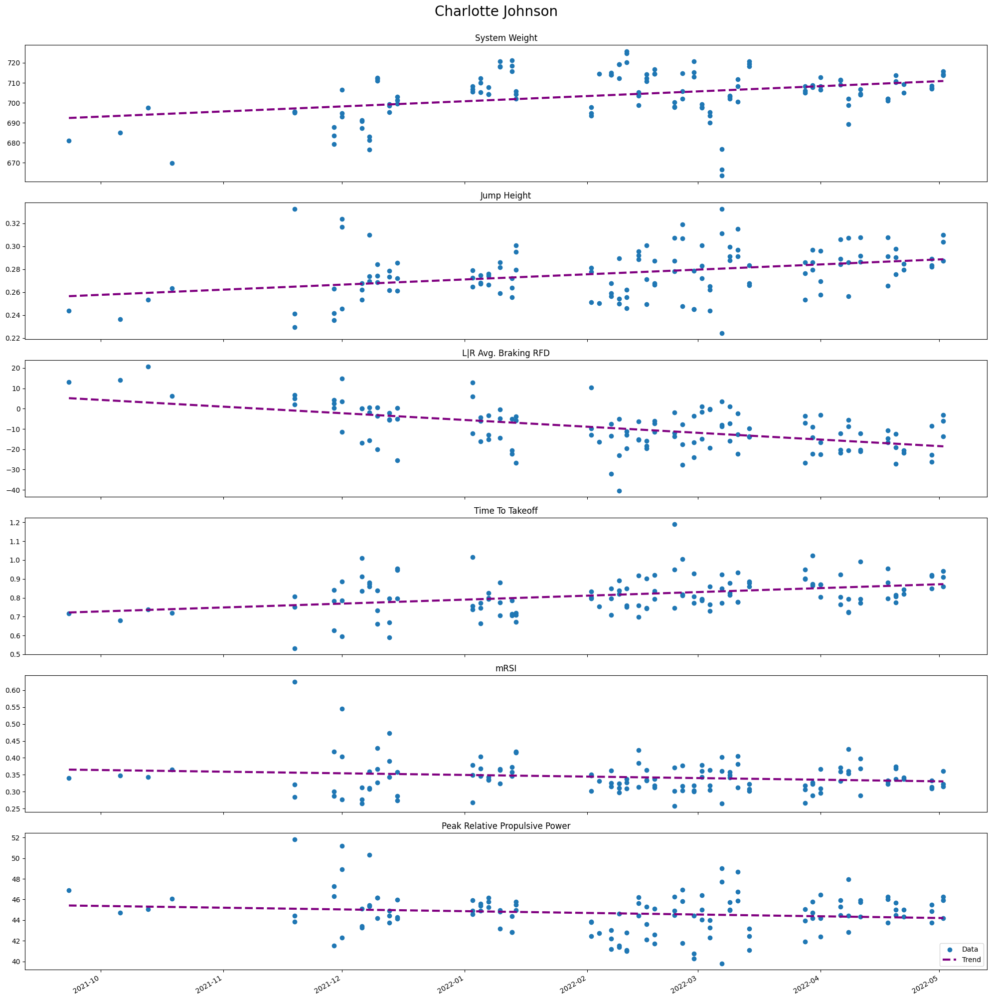

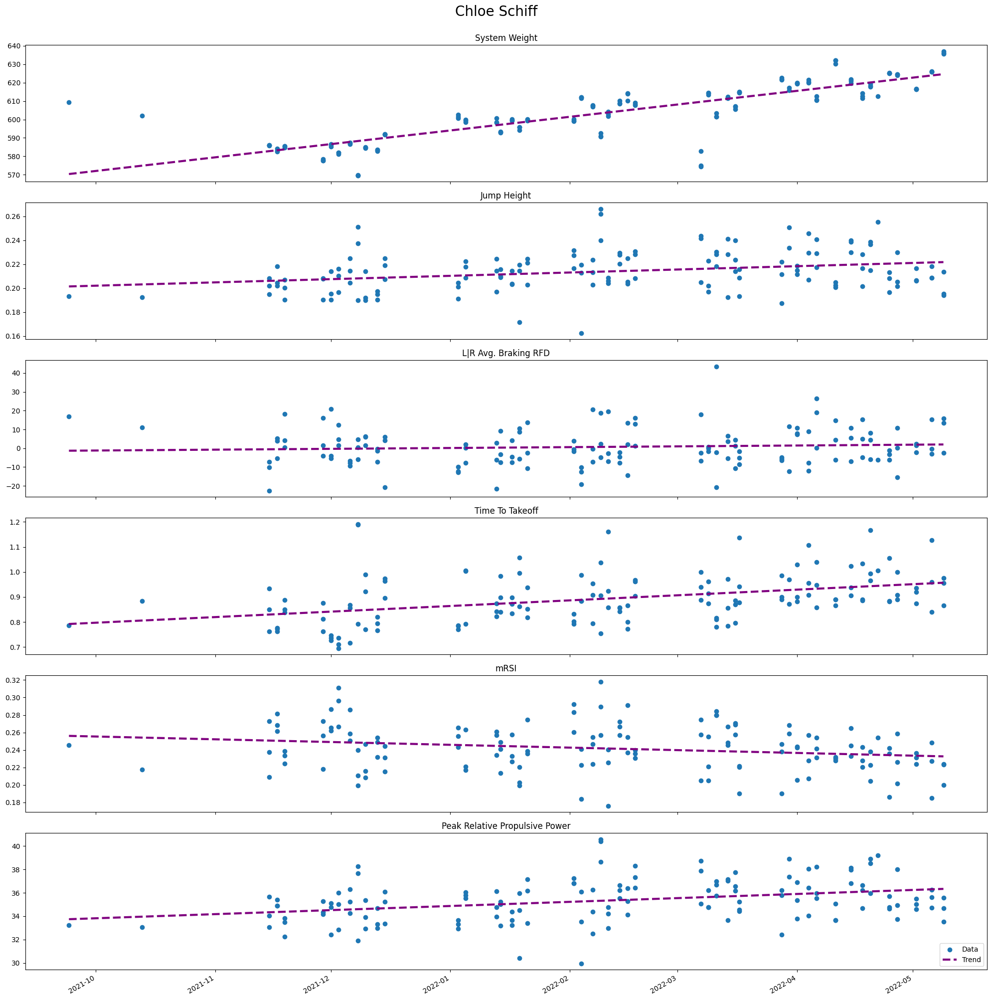

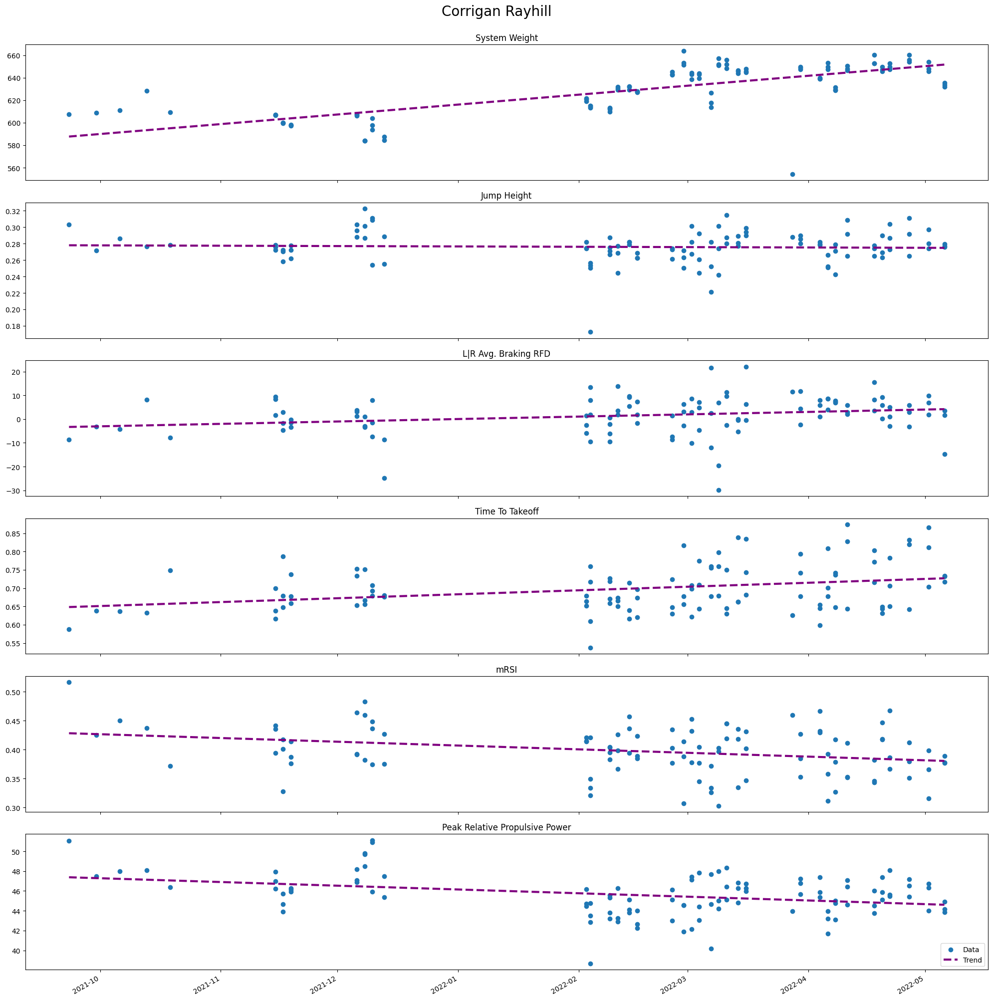

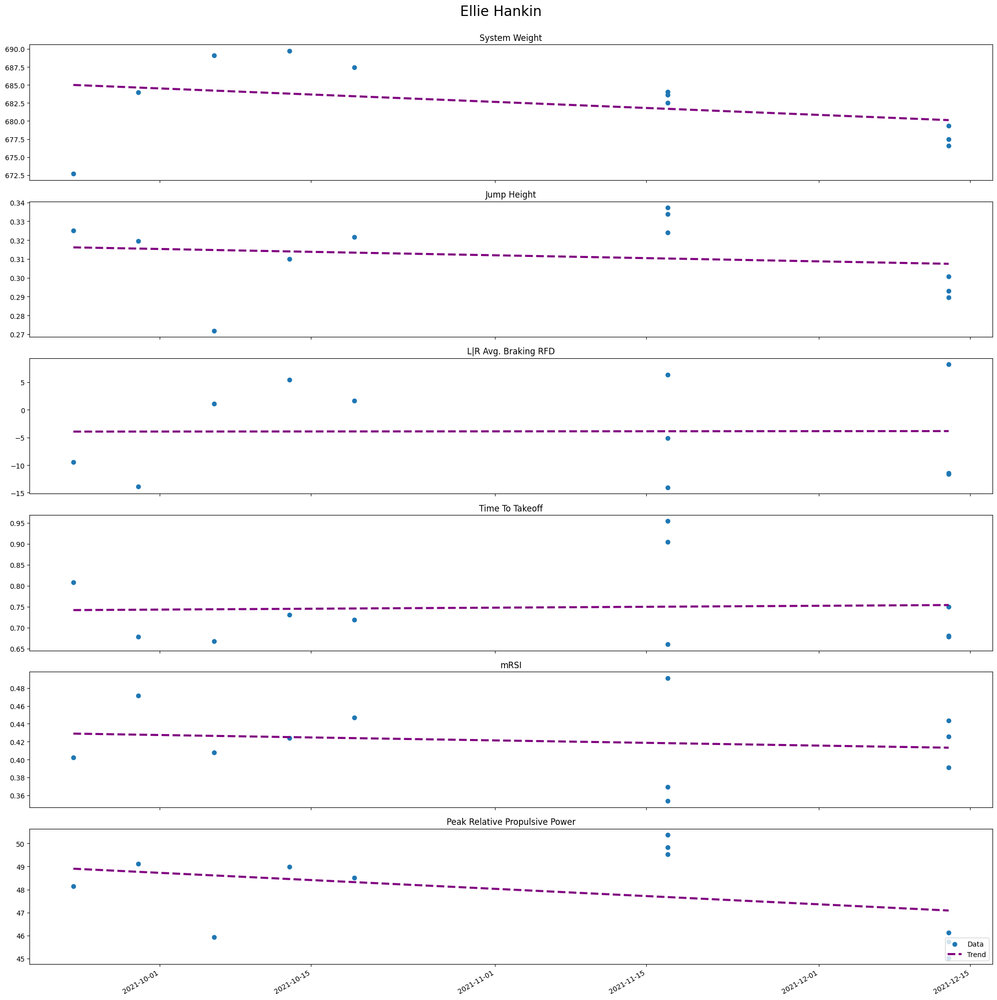

...

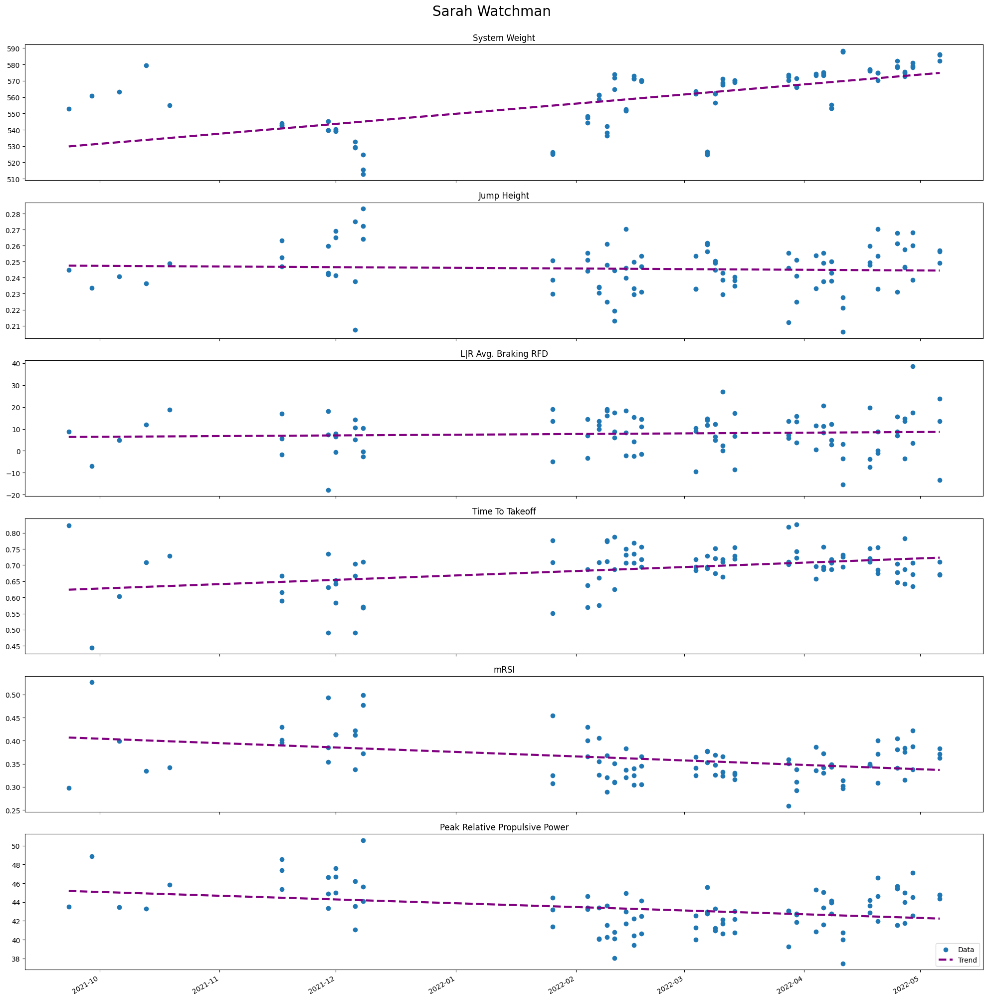

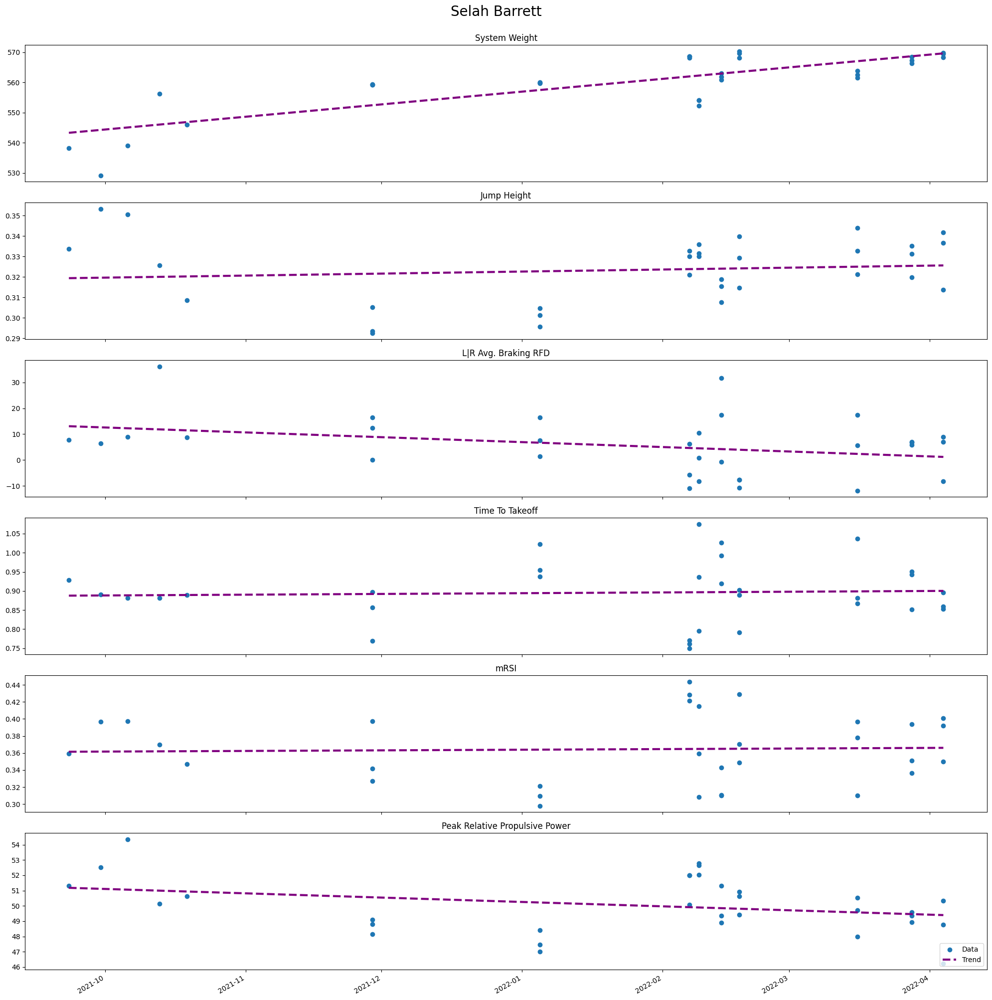

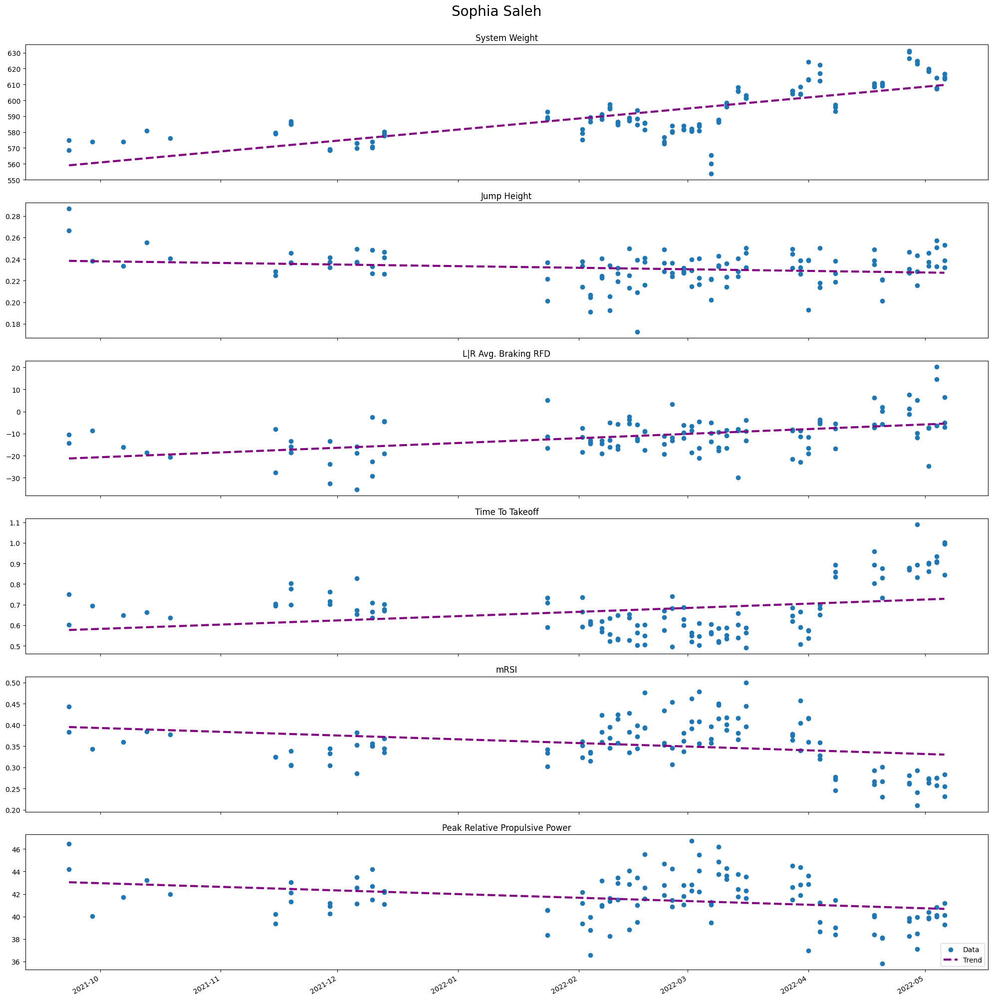

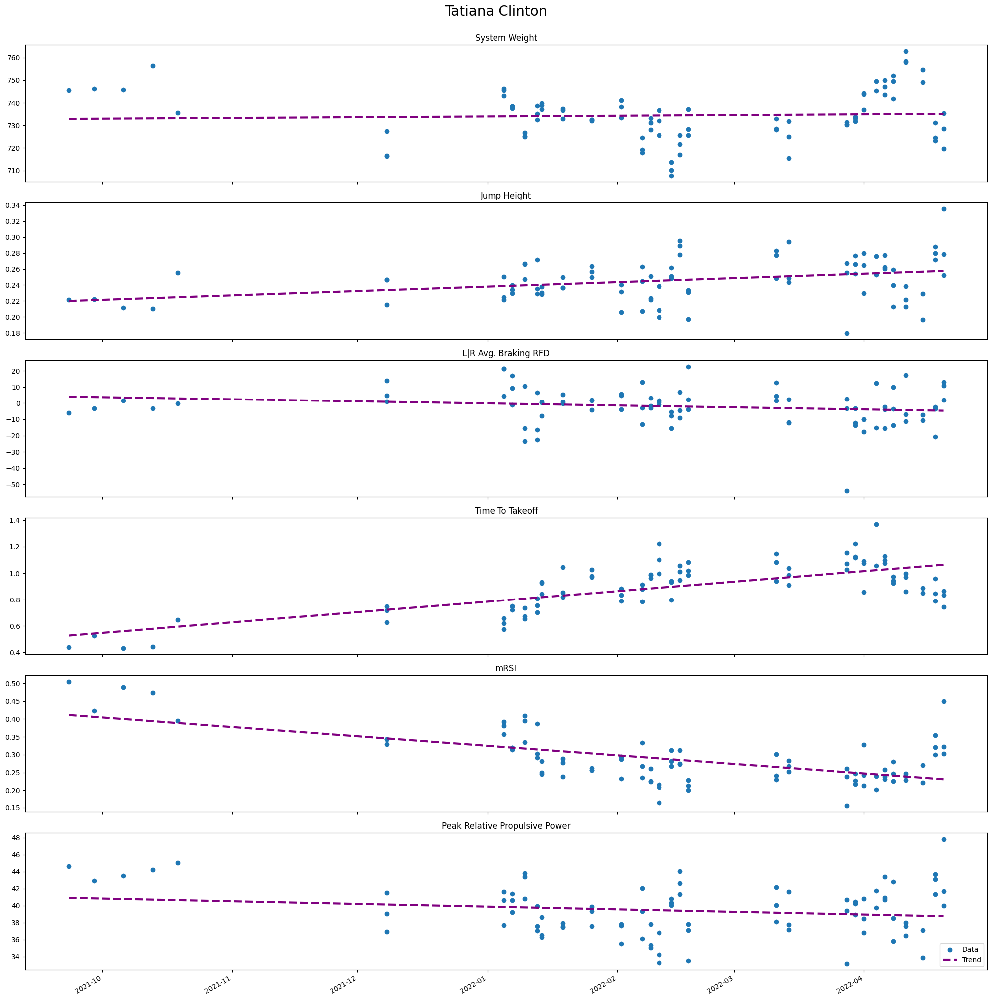

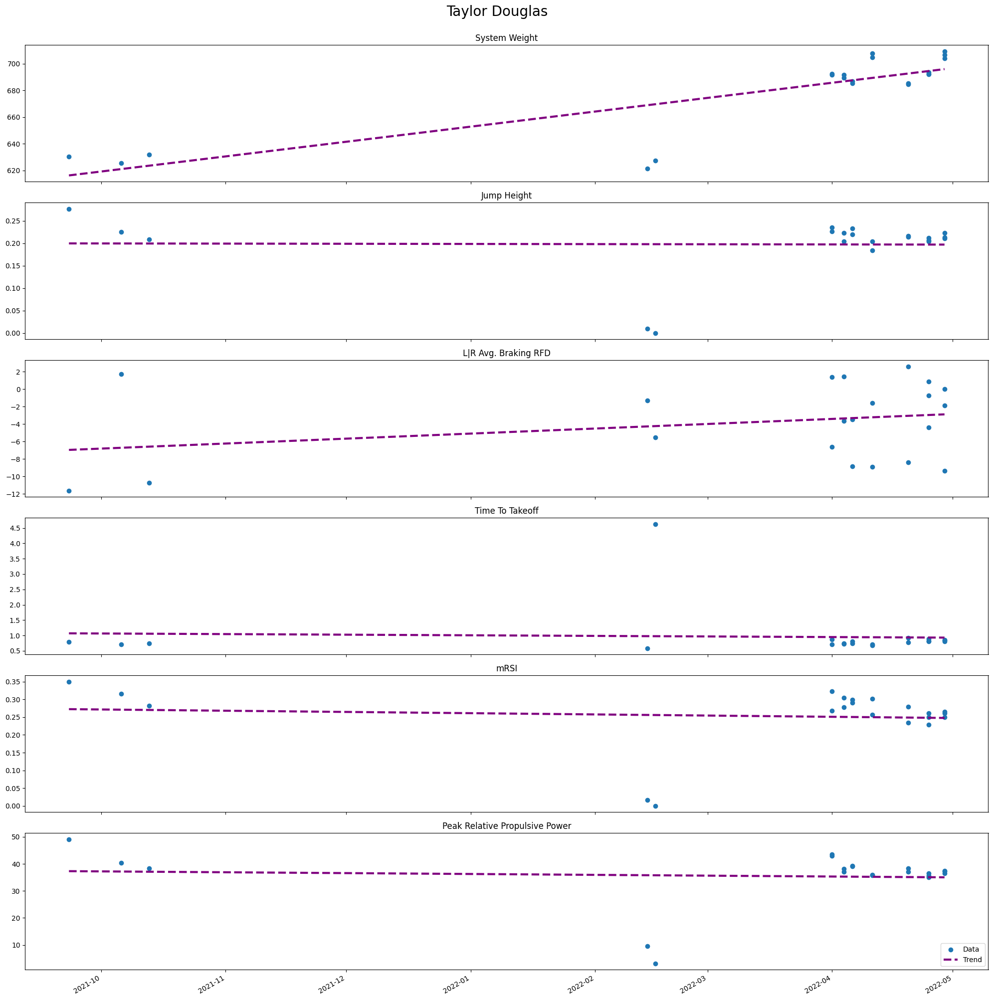

In [ ]:
#test for fall individual data
aObj.fallGraphsIndAll()

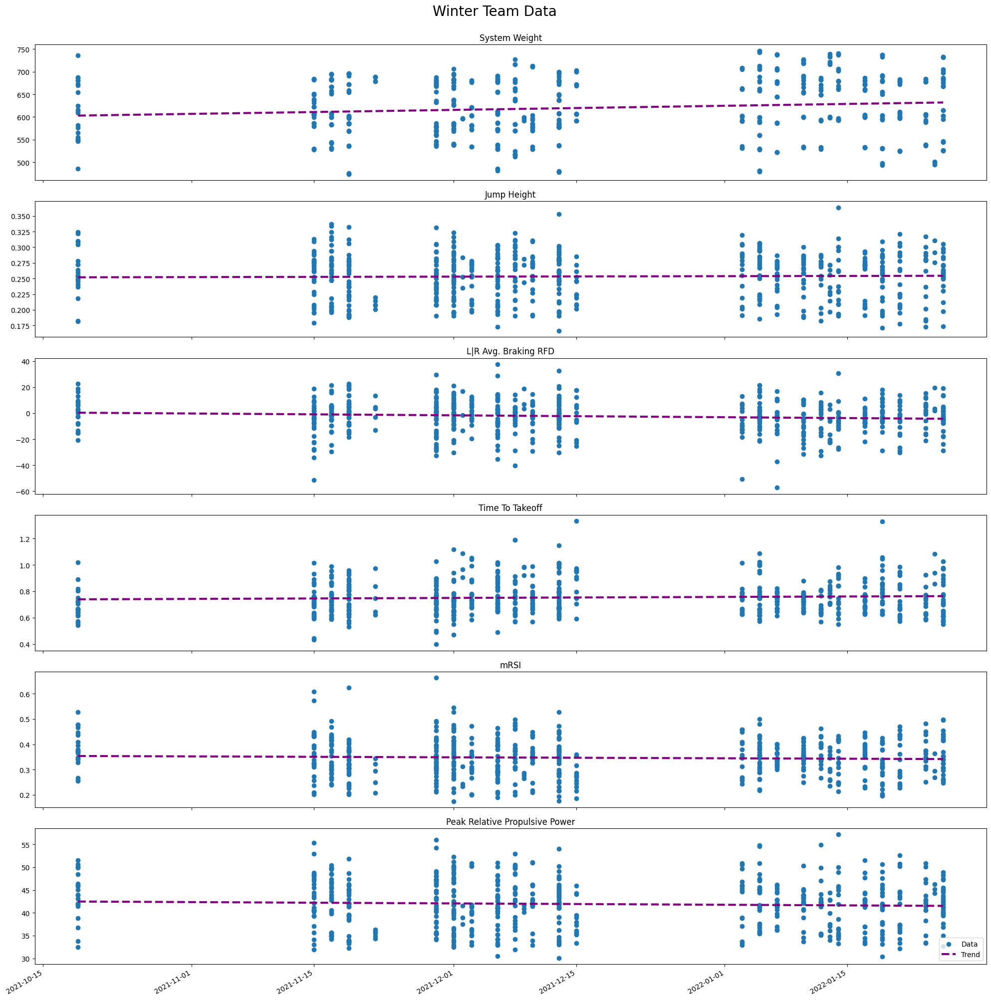

In [ ]:
#test for all team winter data
aObj.winterGraphs()

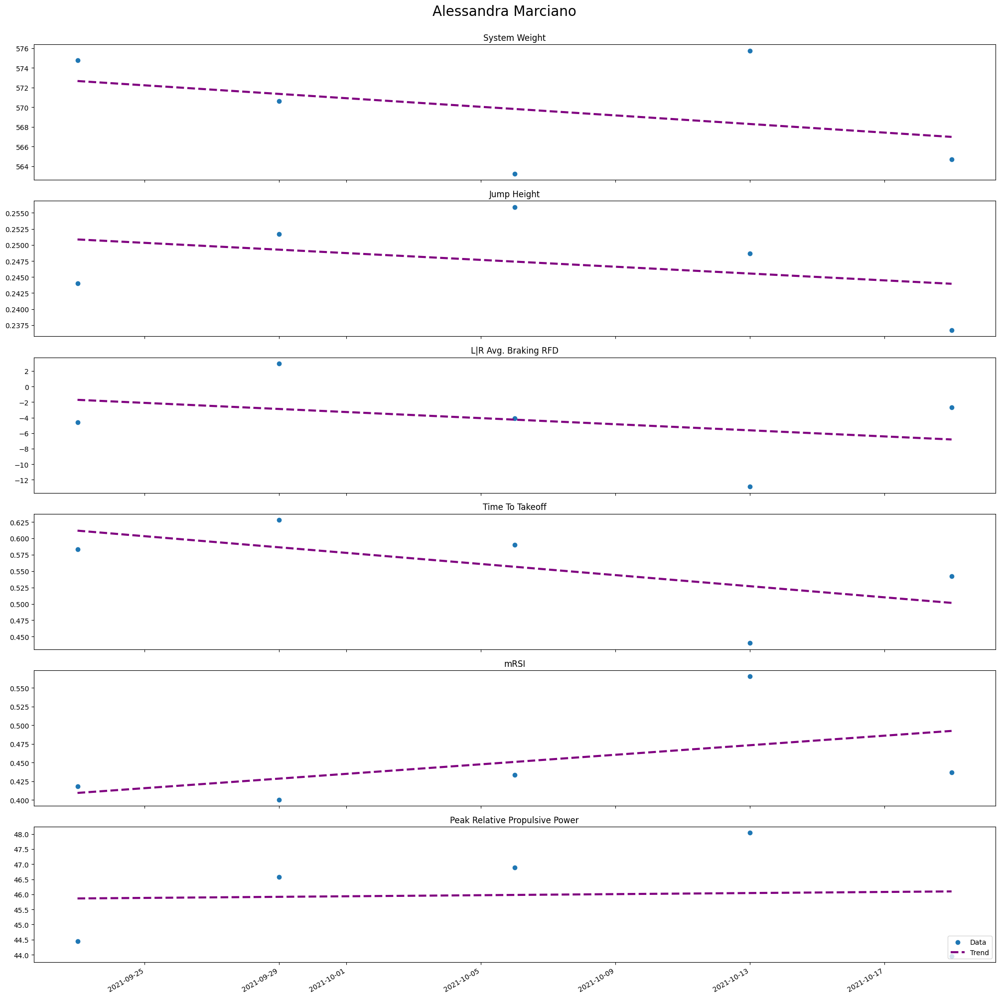

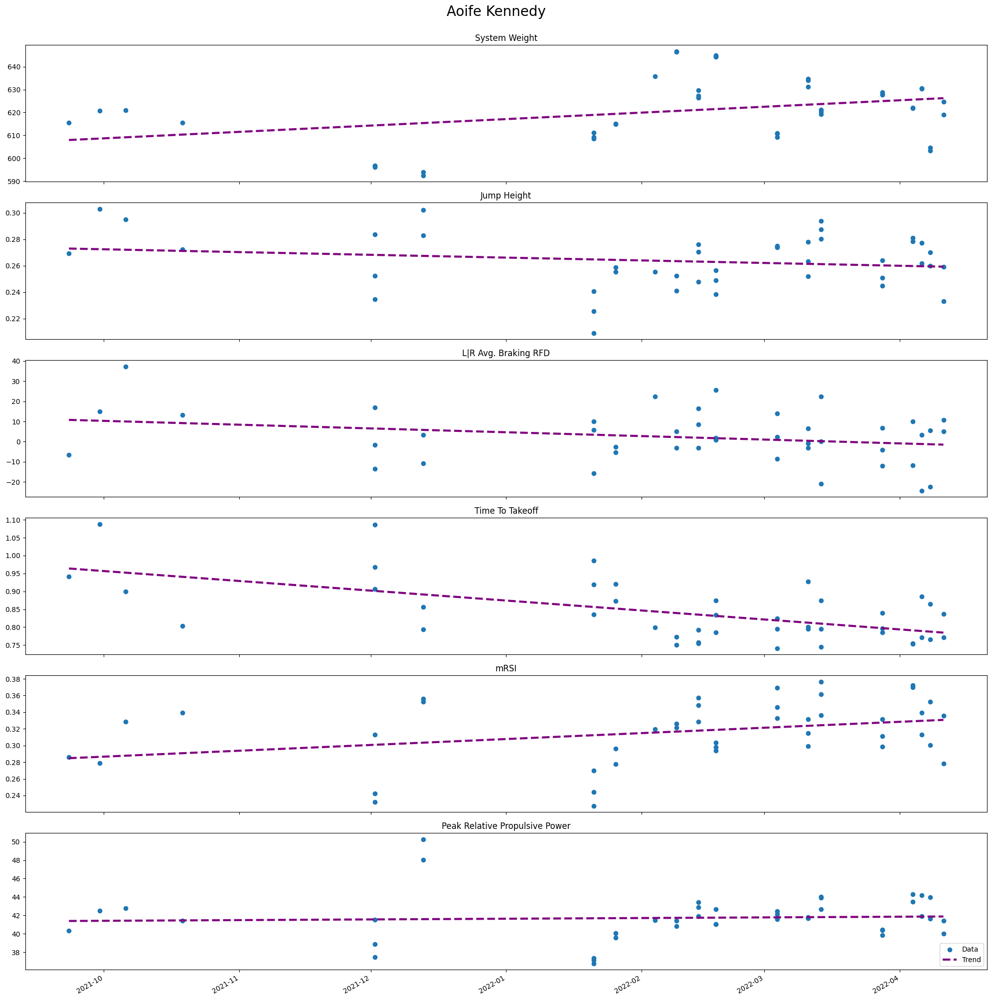

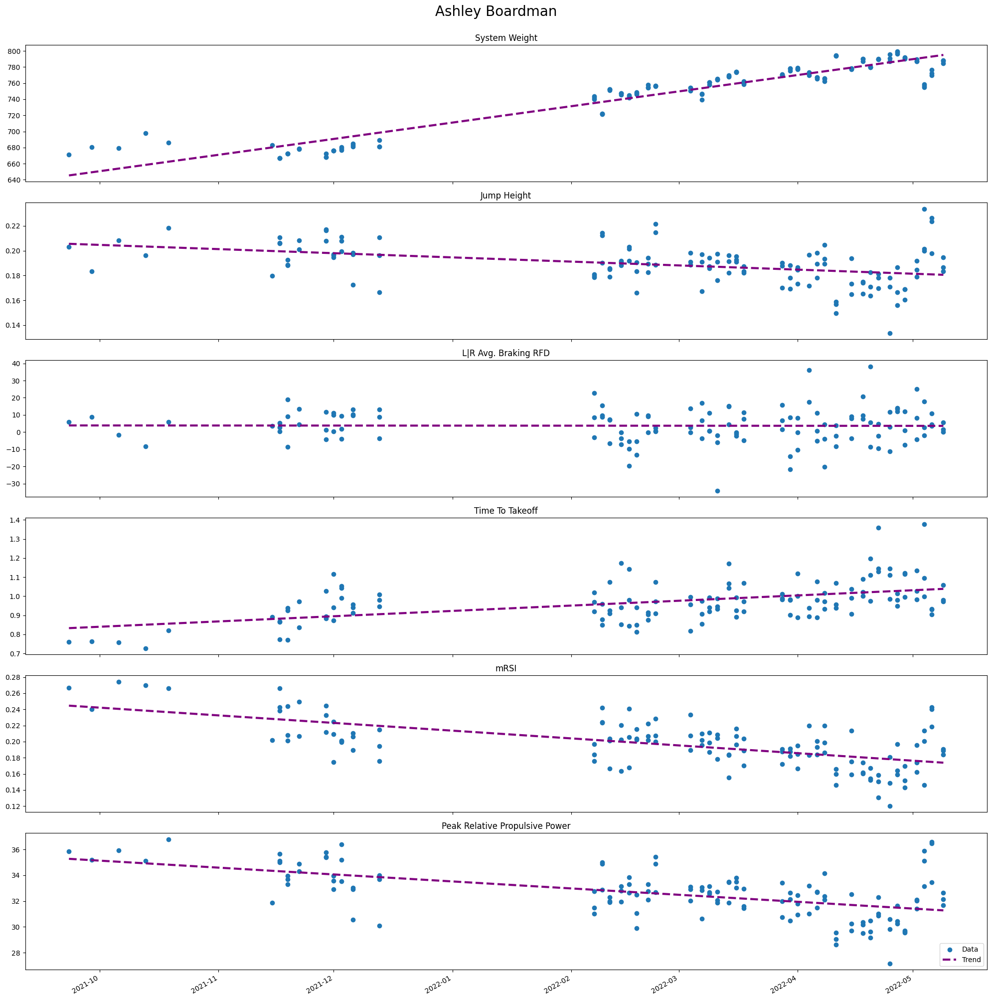

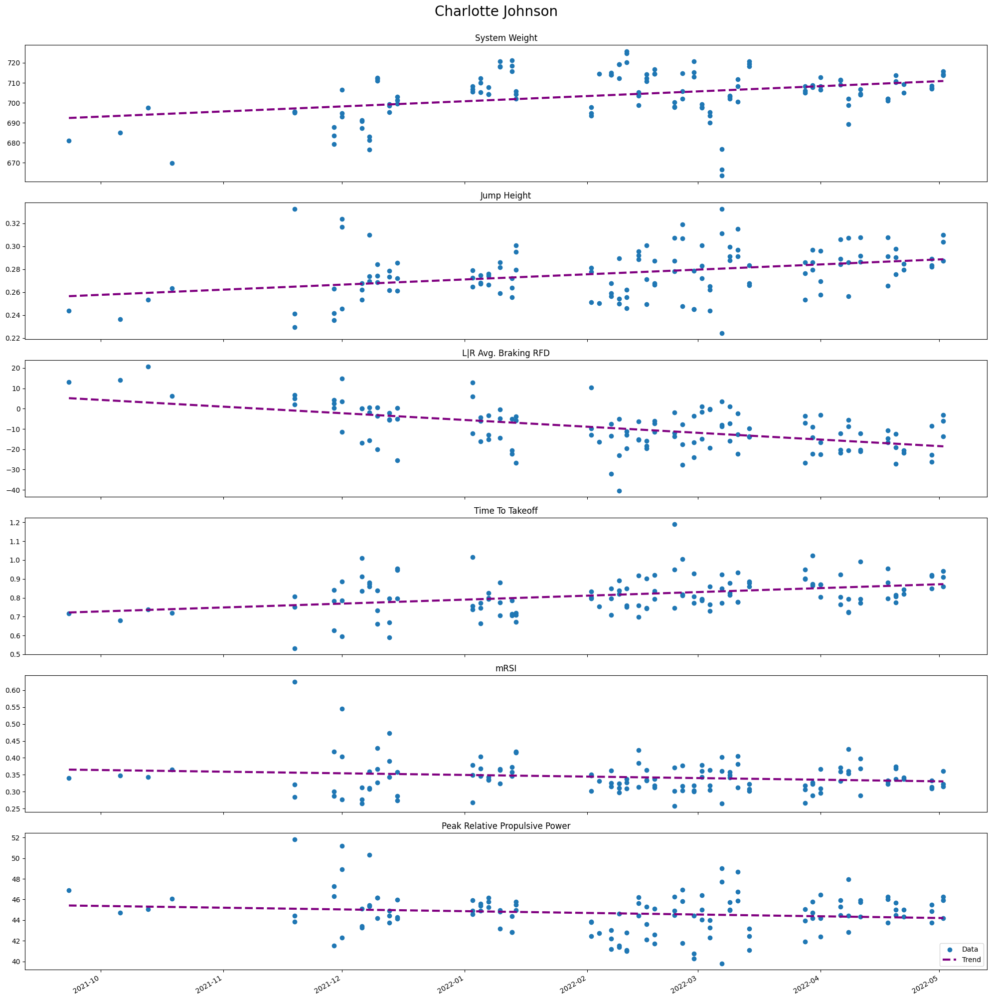

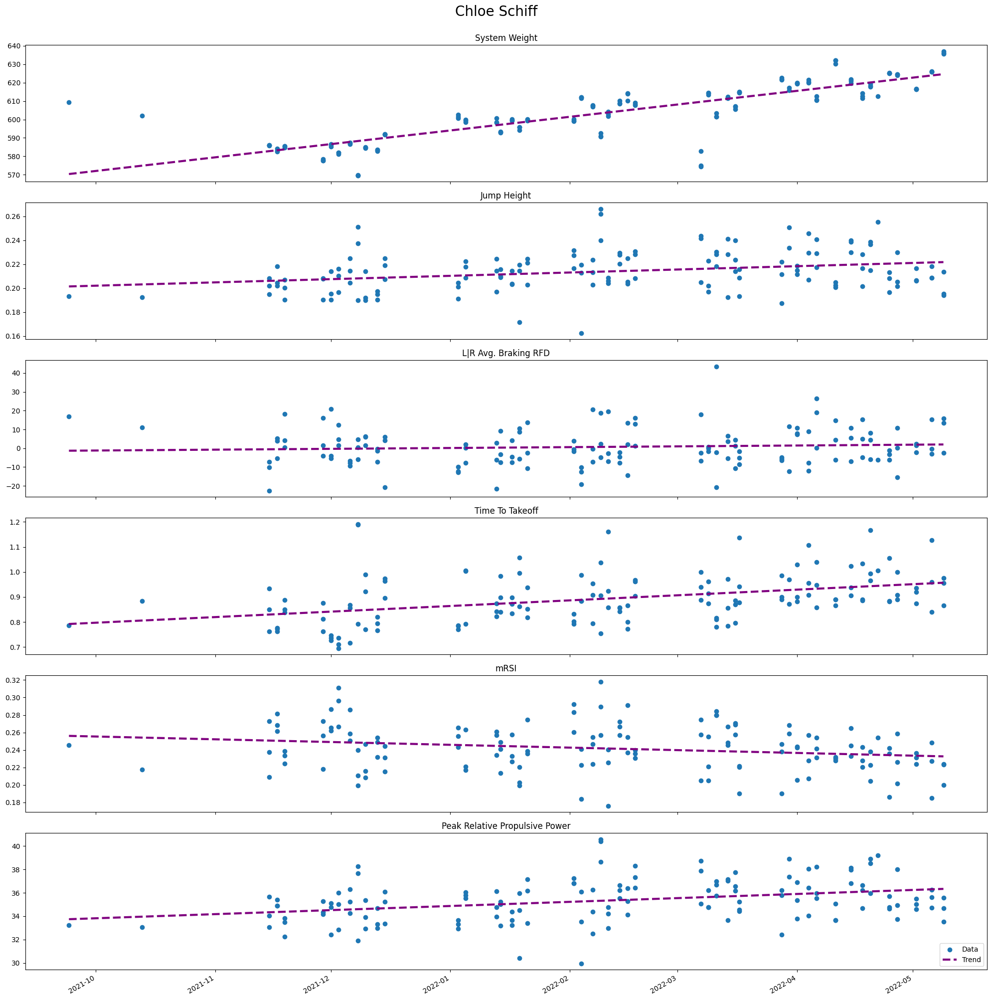

...

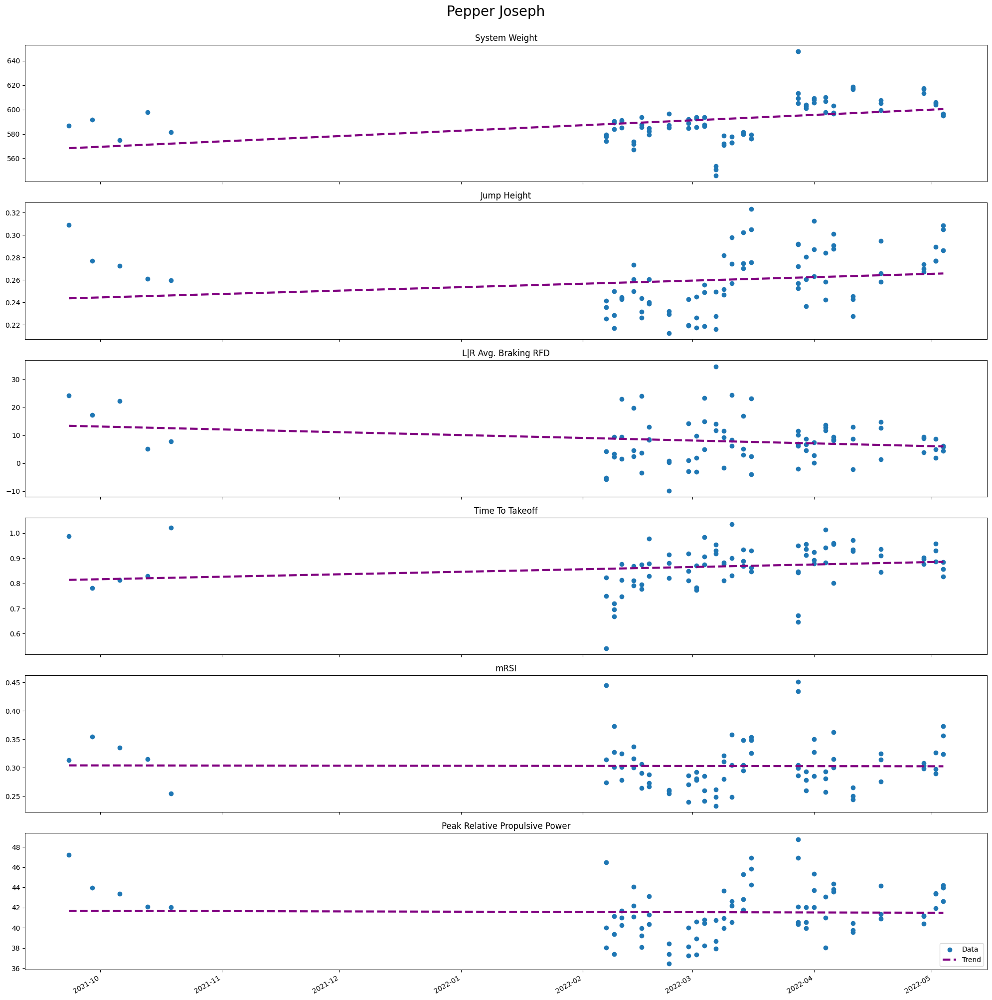

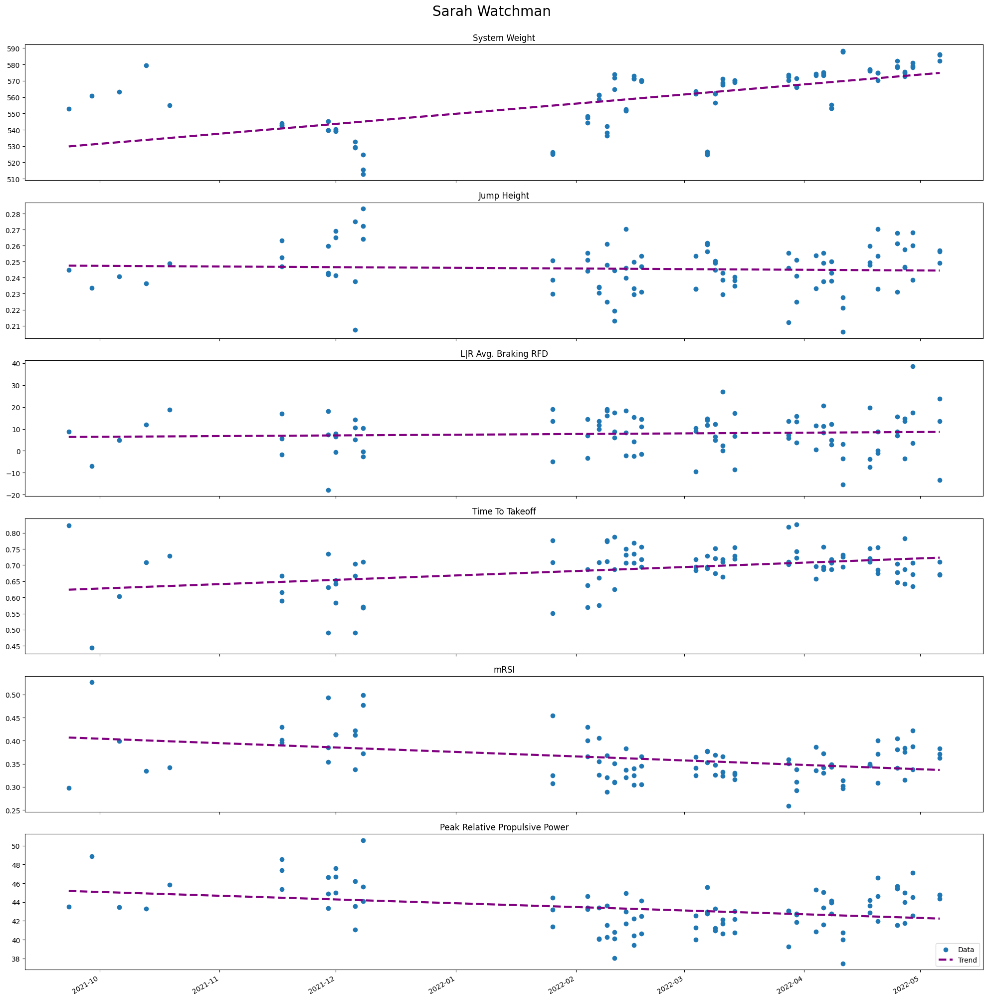

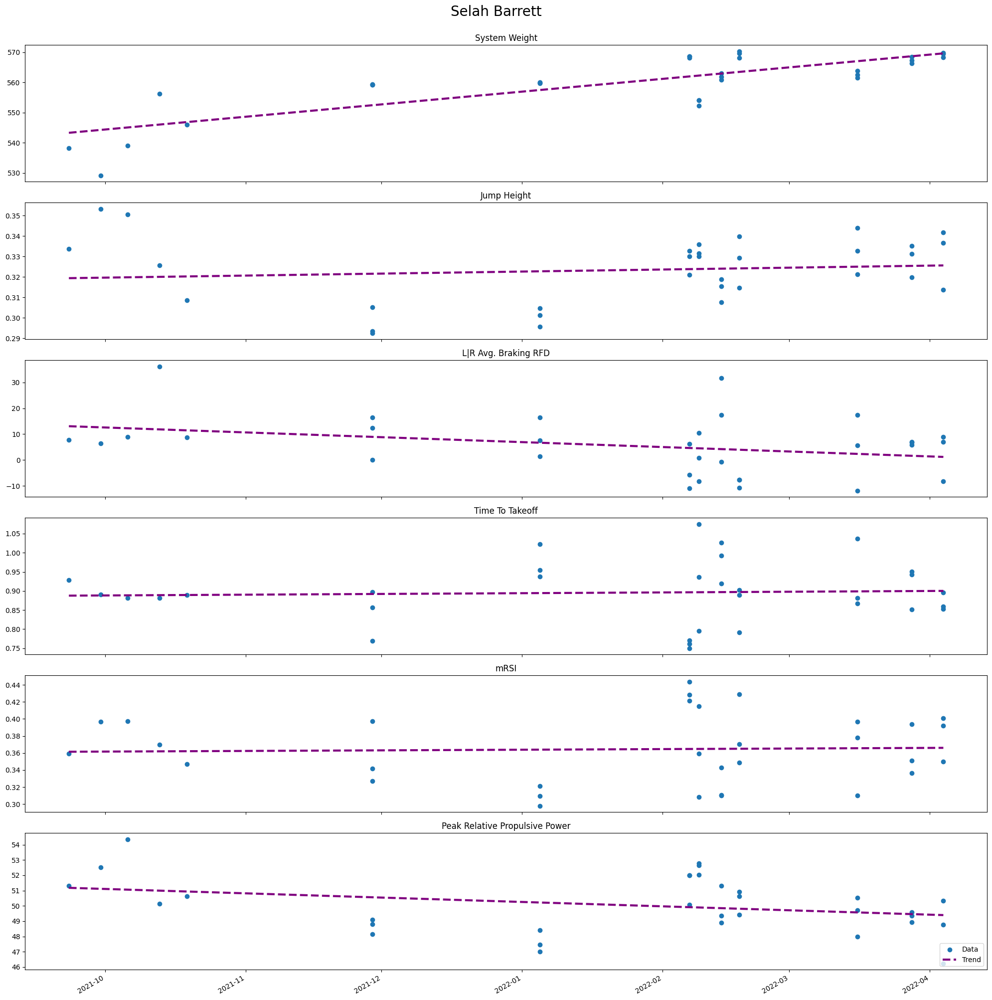

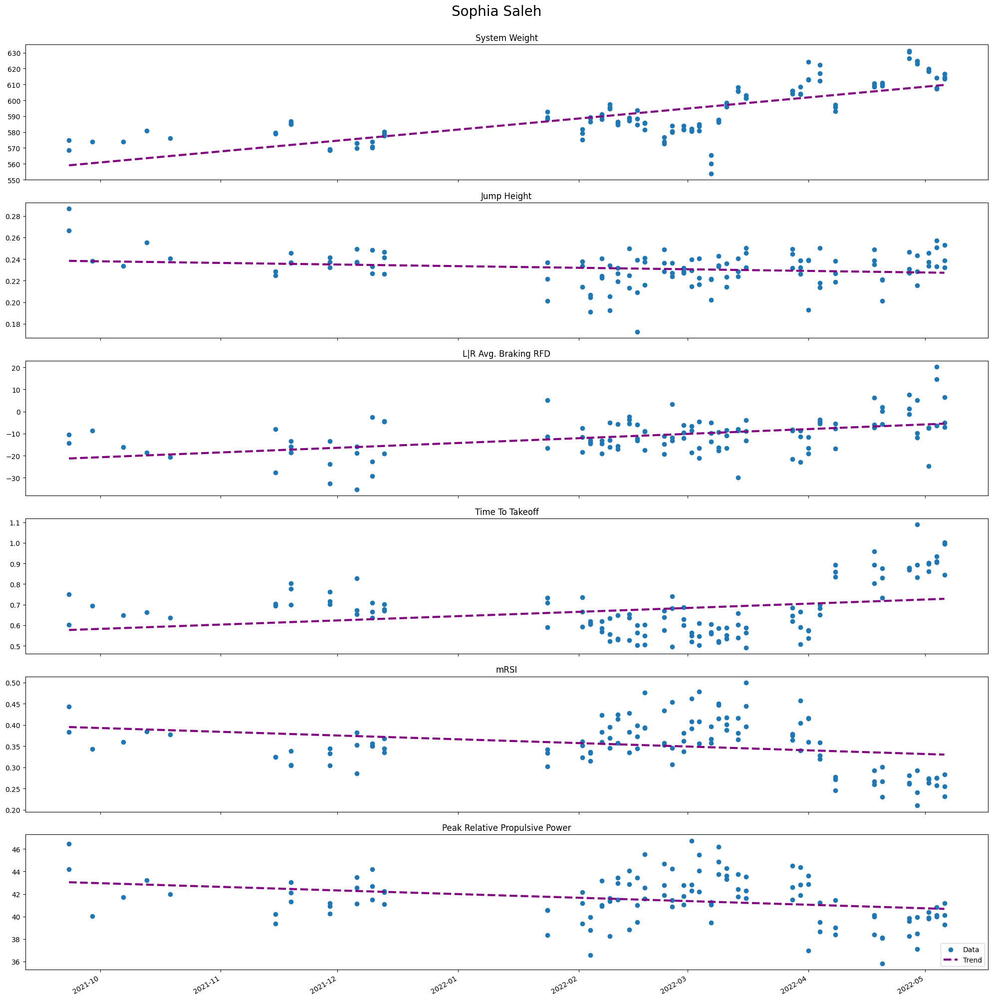

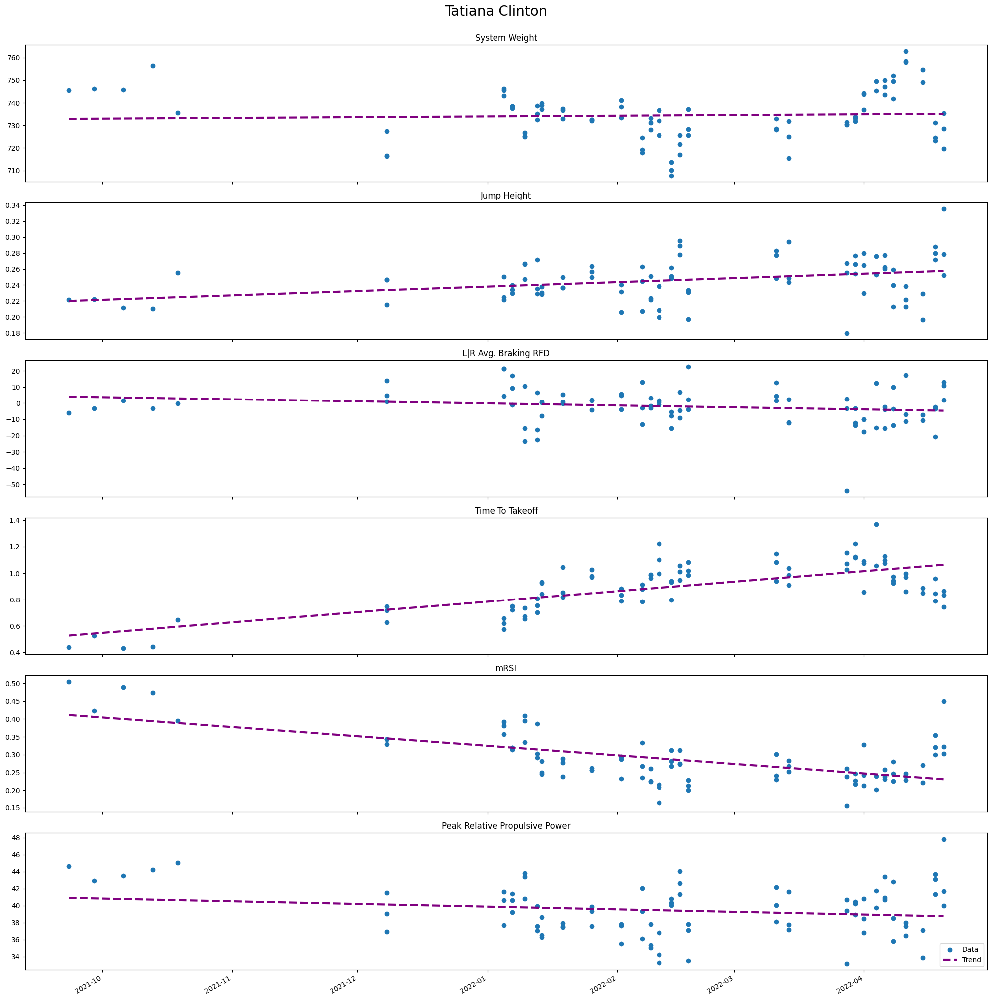

In [ ]:
#test for winter individual graphs 
aObj.winterGraphsIndAll()

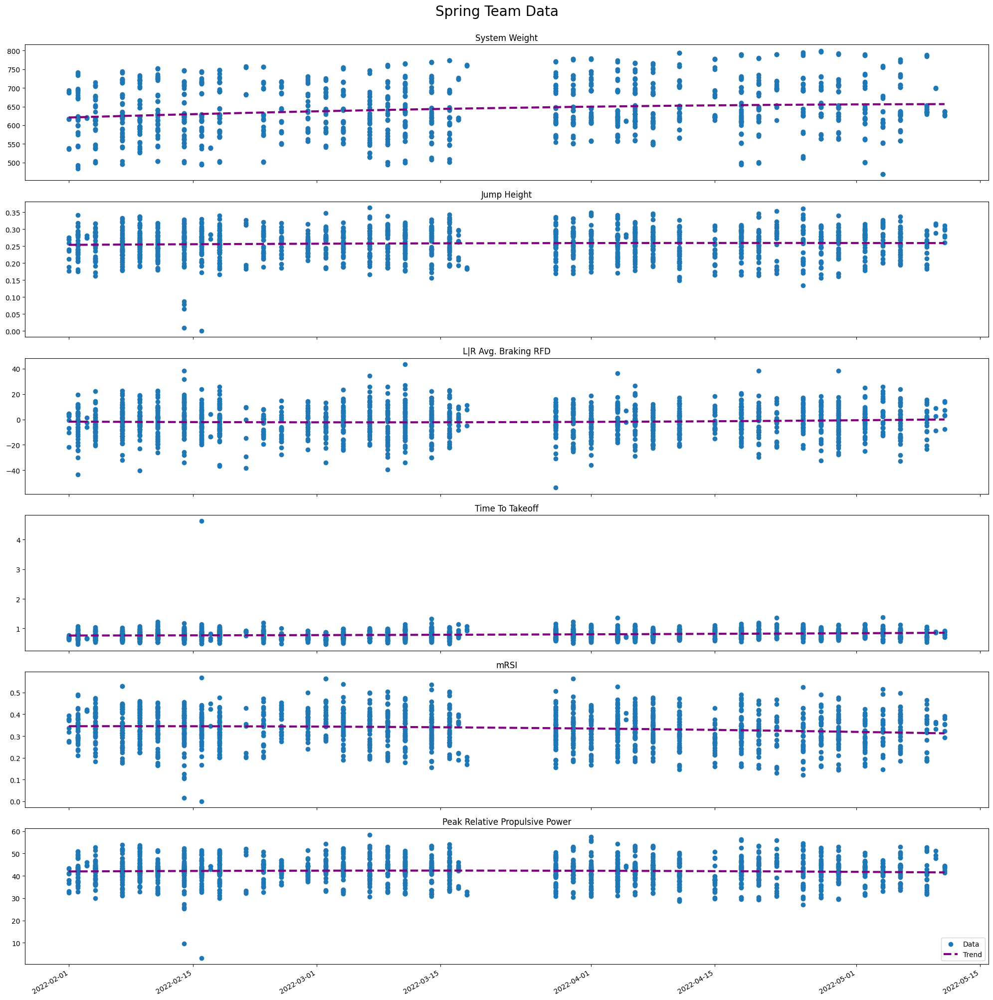

In [ ]:
#test spring graphs
aObj.springGraphs()

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


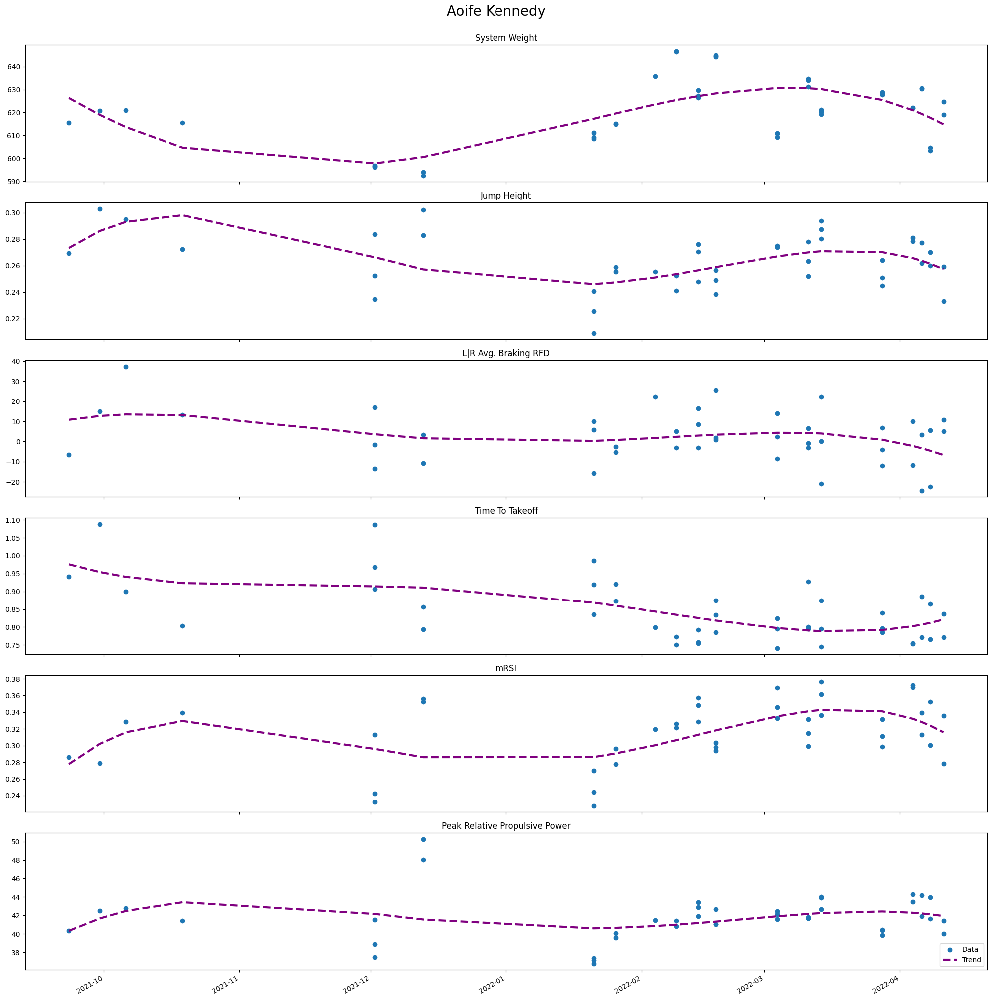

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


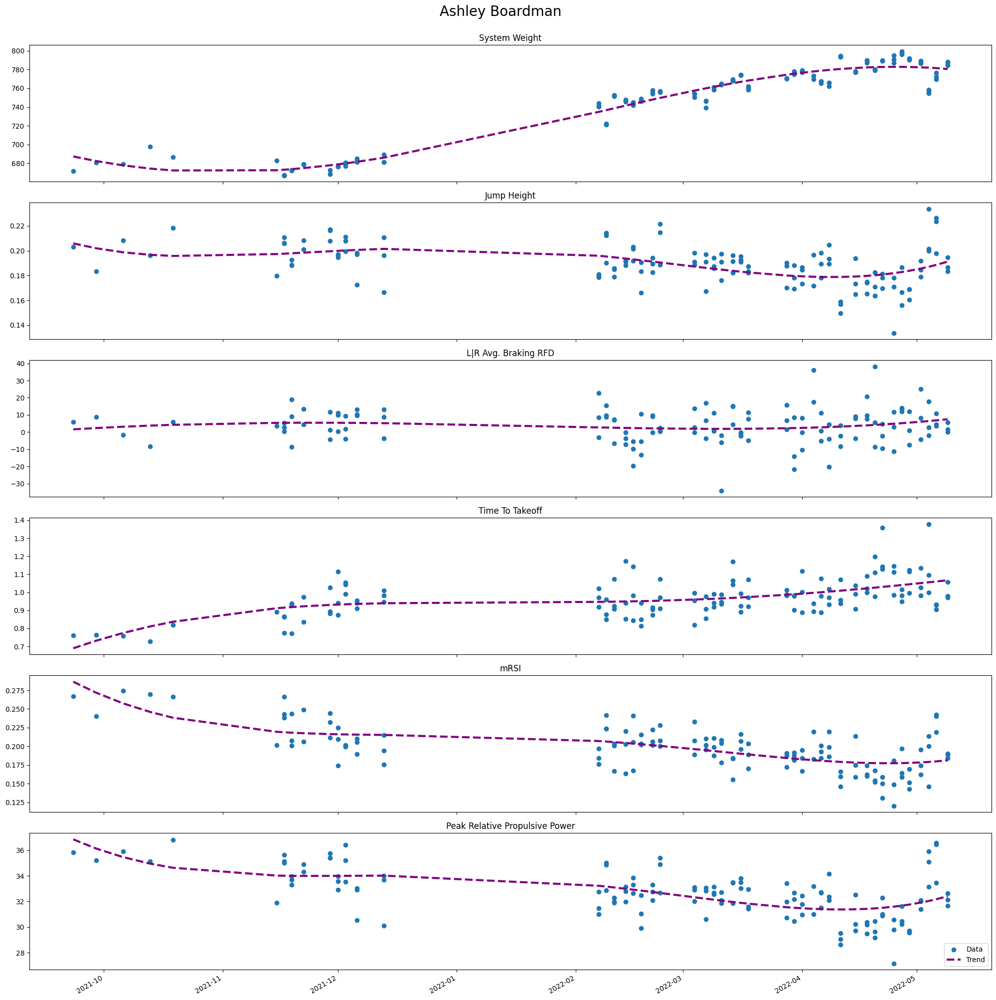

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


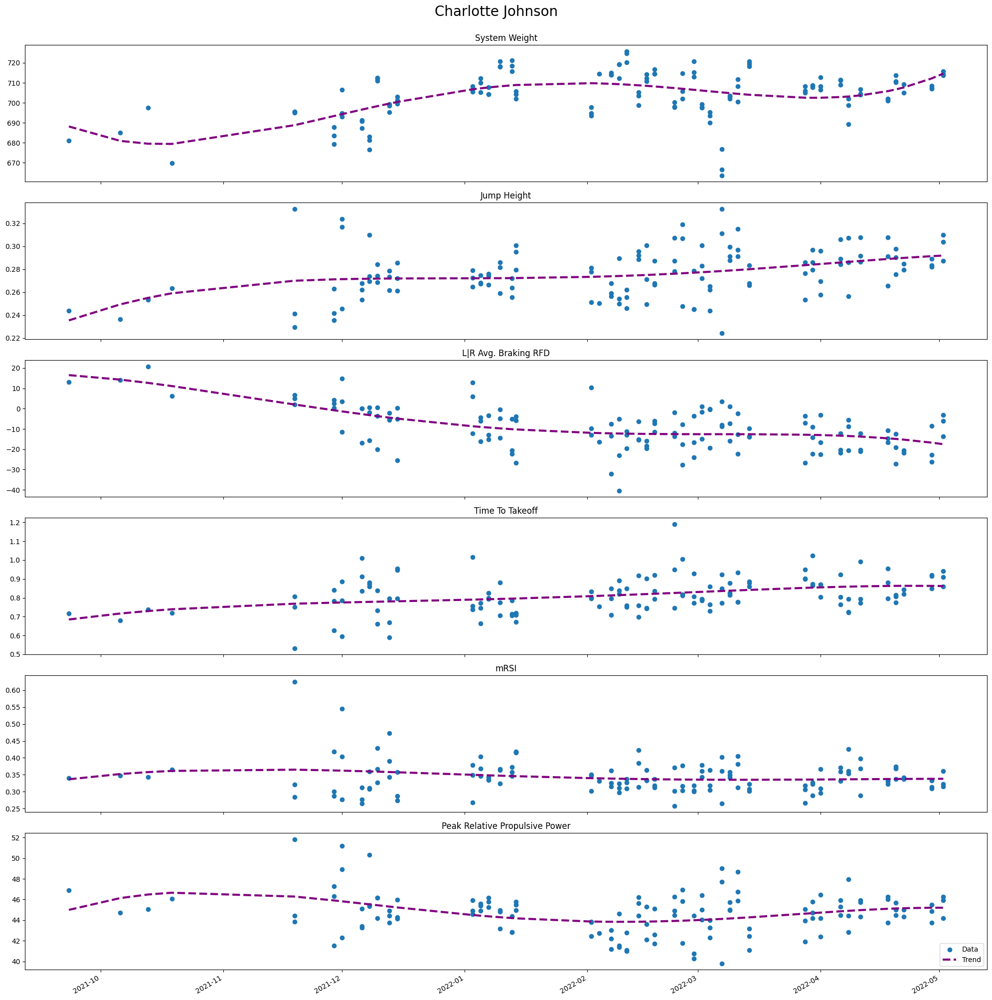

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


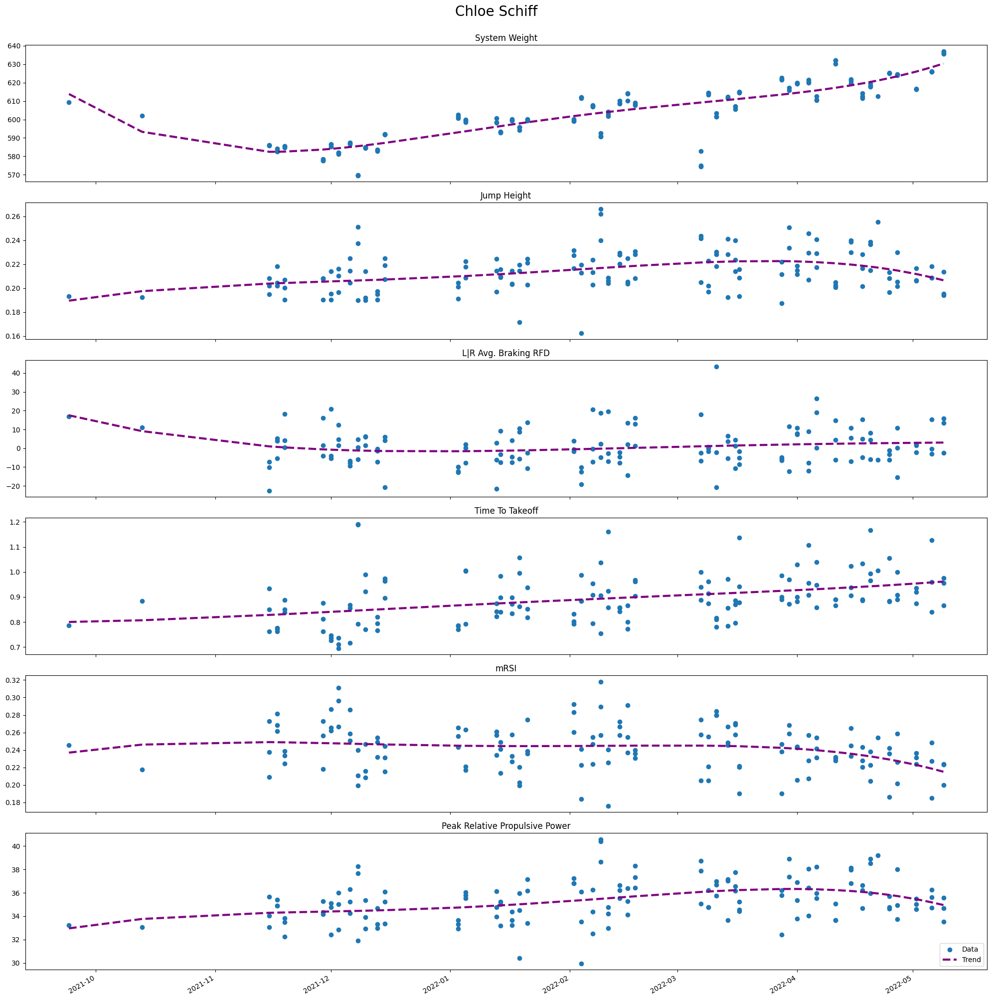

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


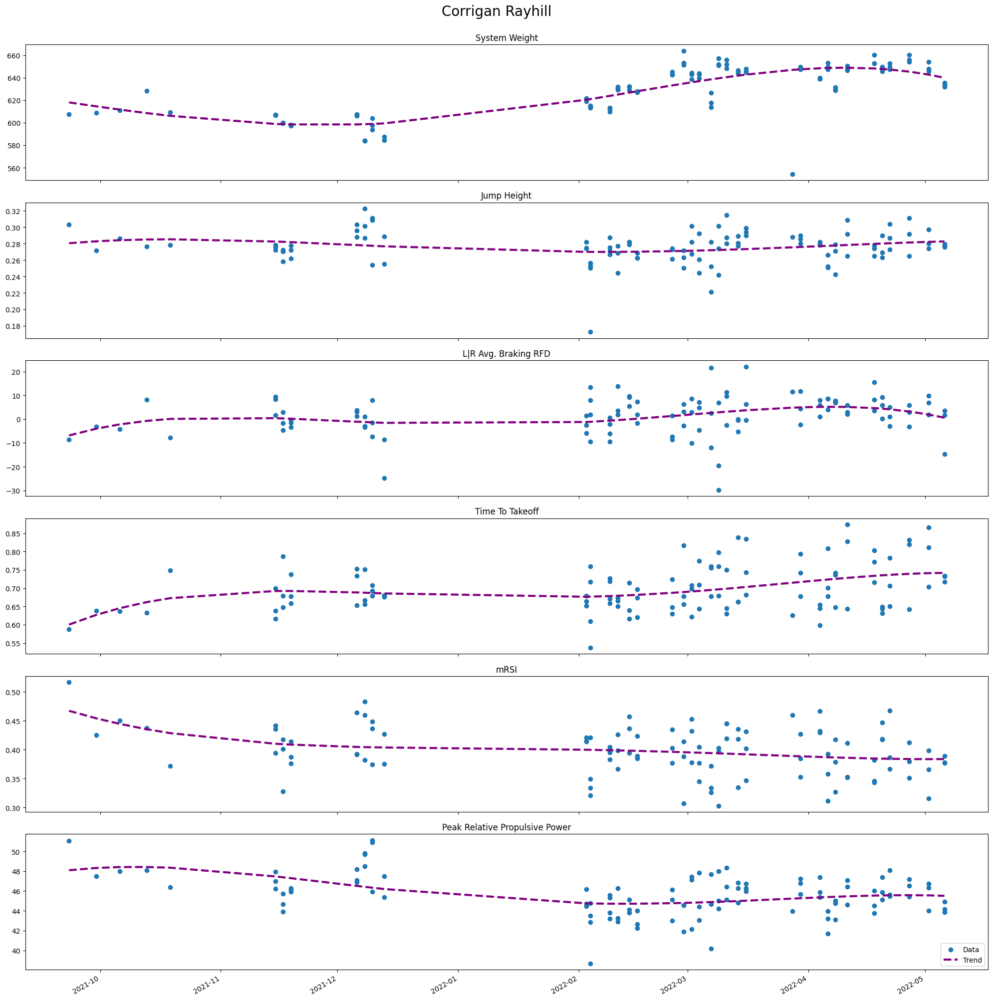

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


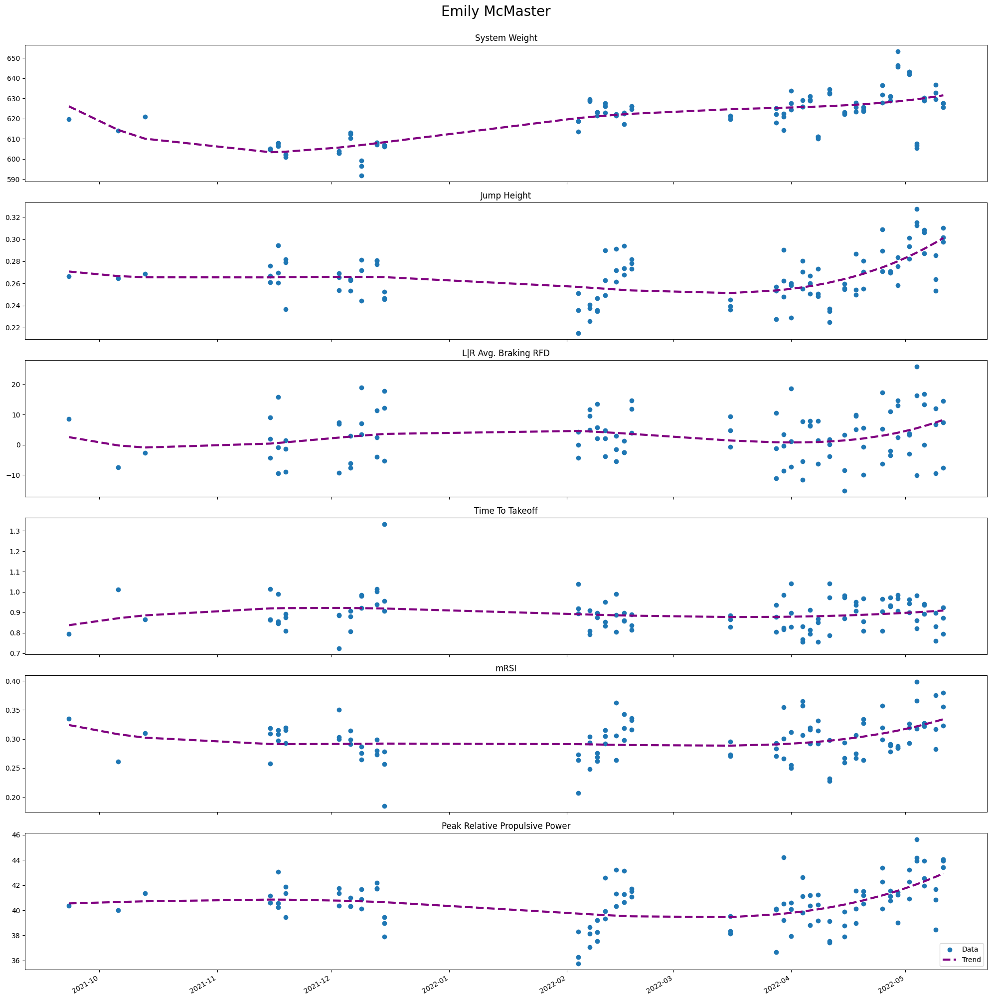

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


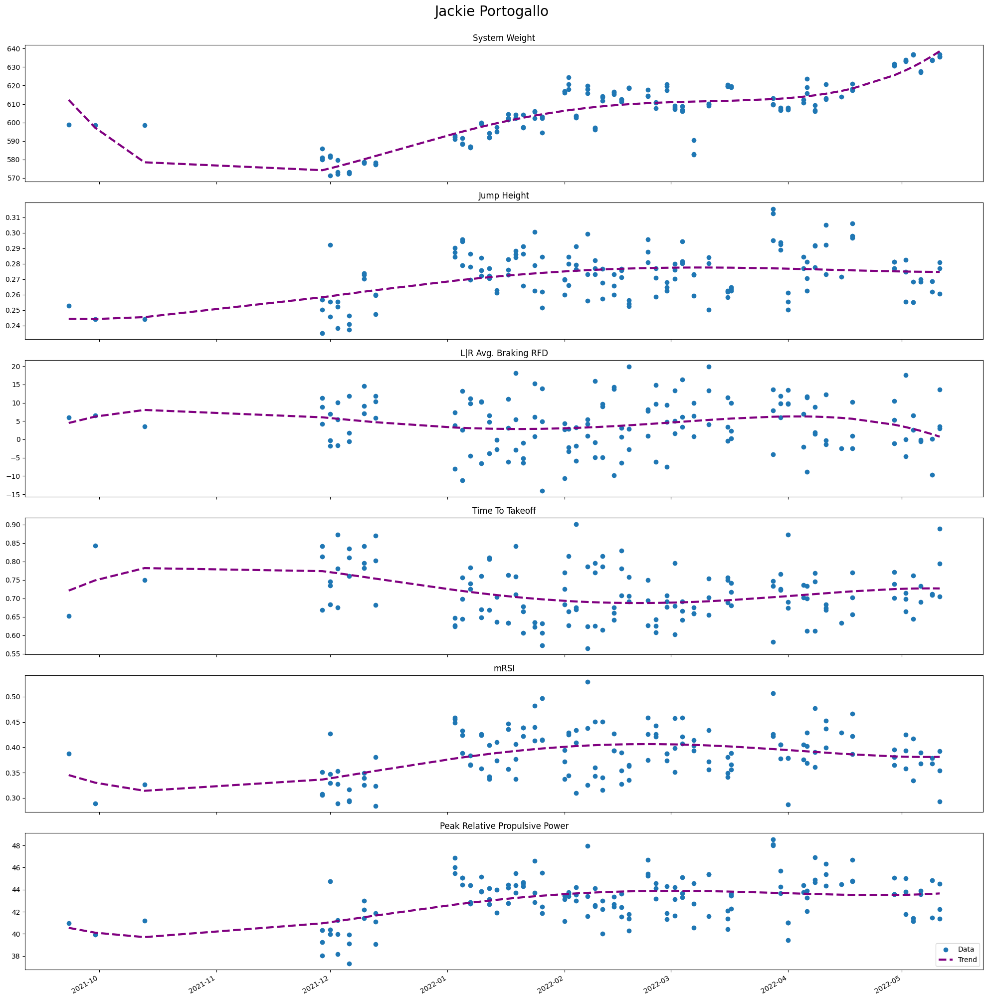

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


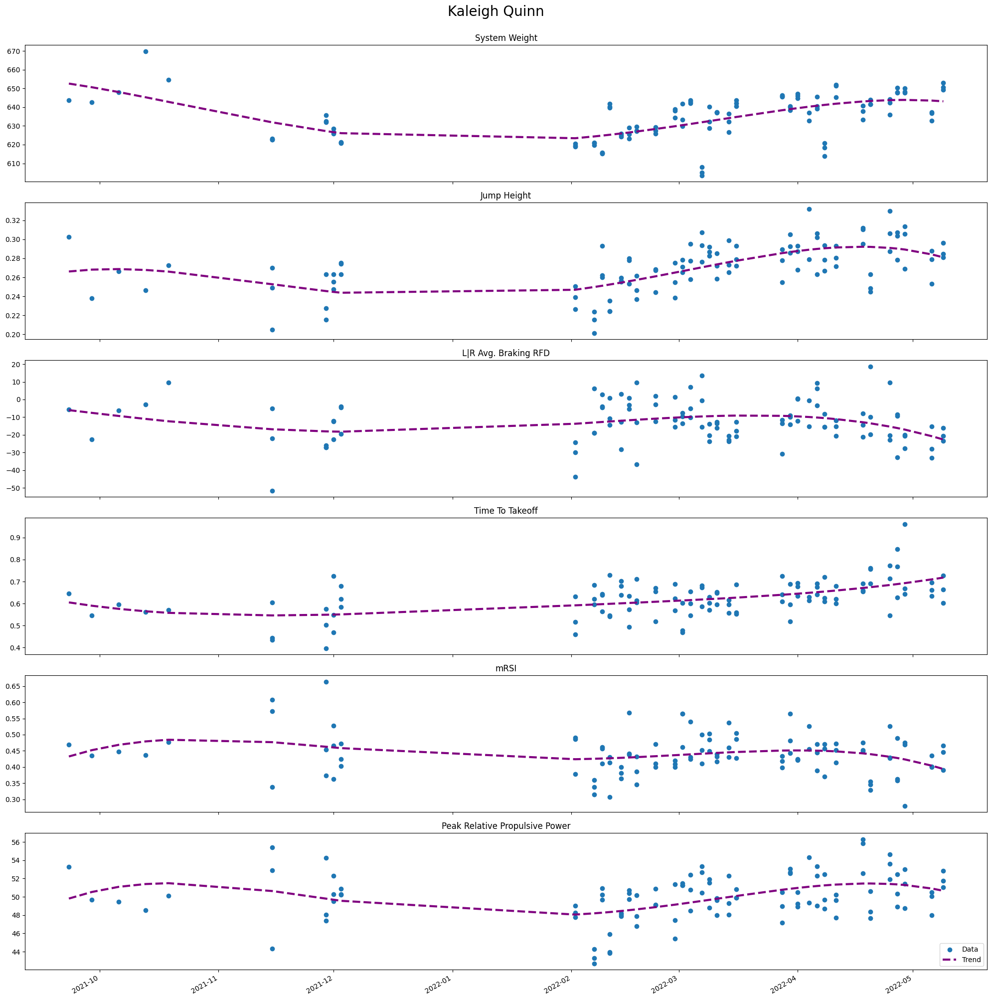

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


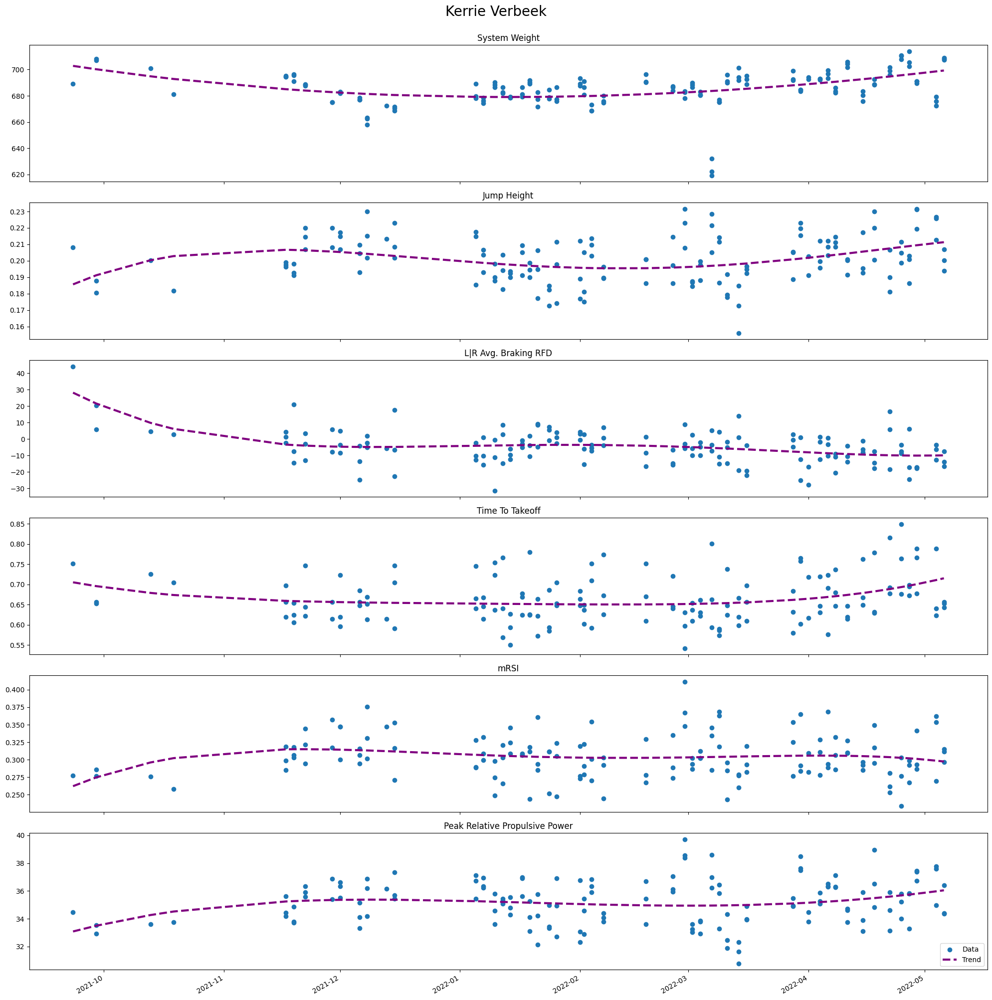

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


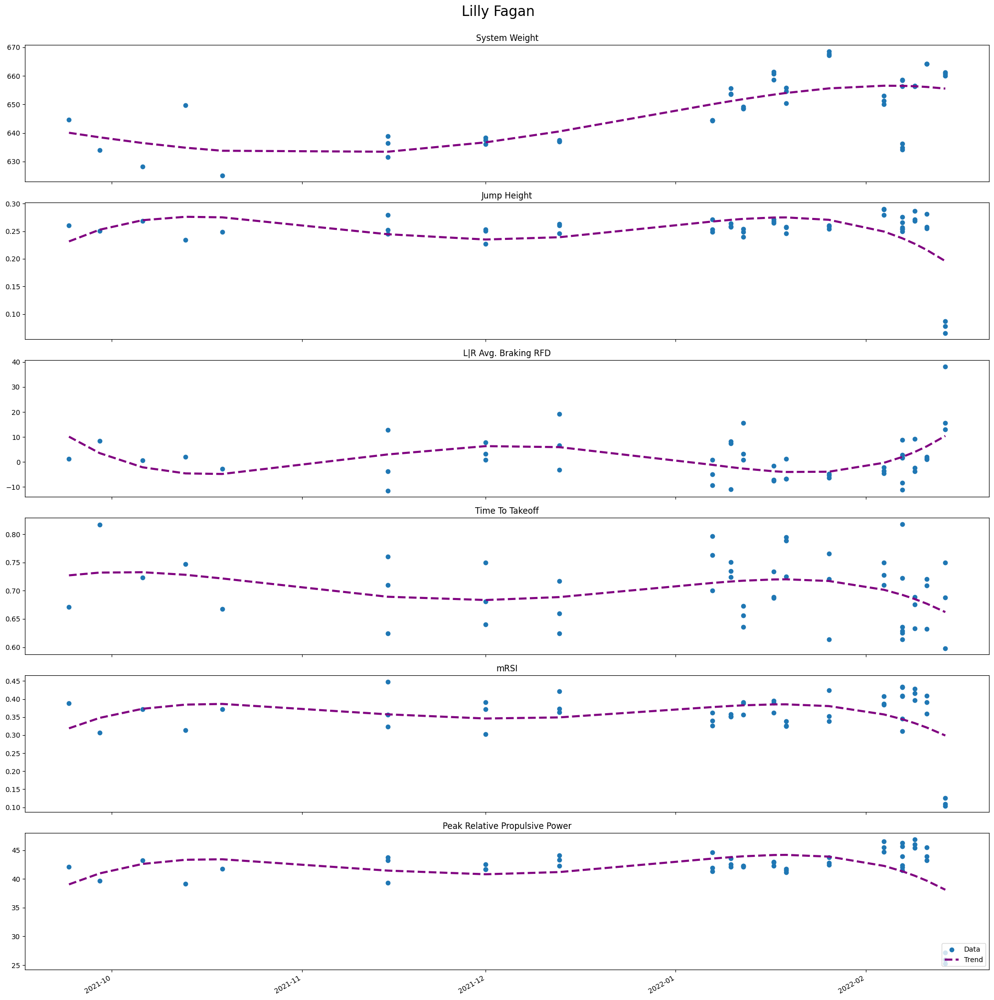

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


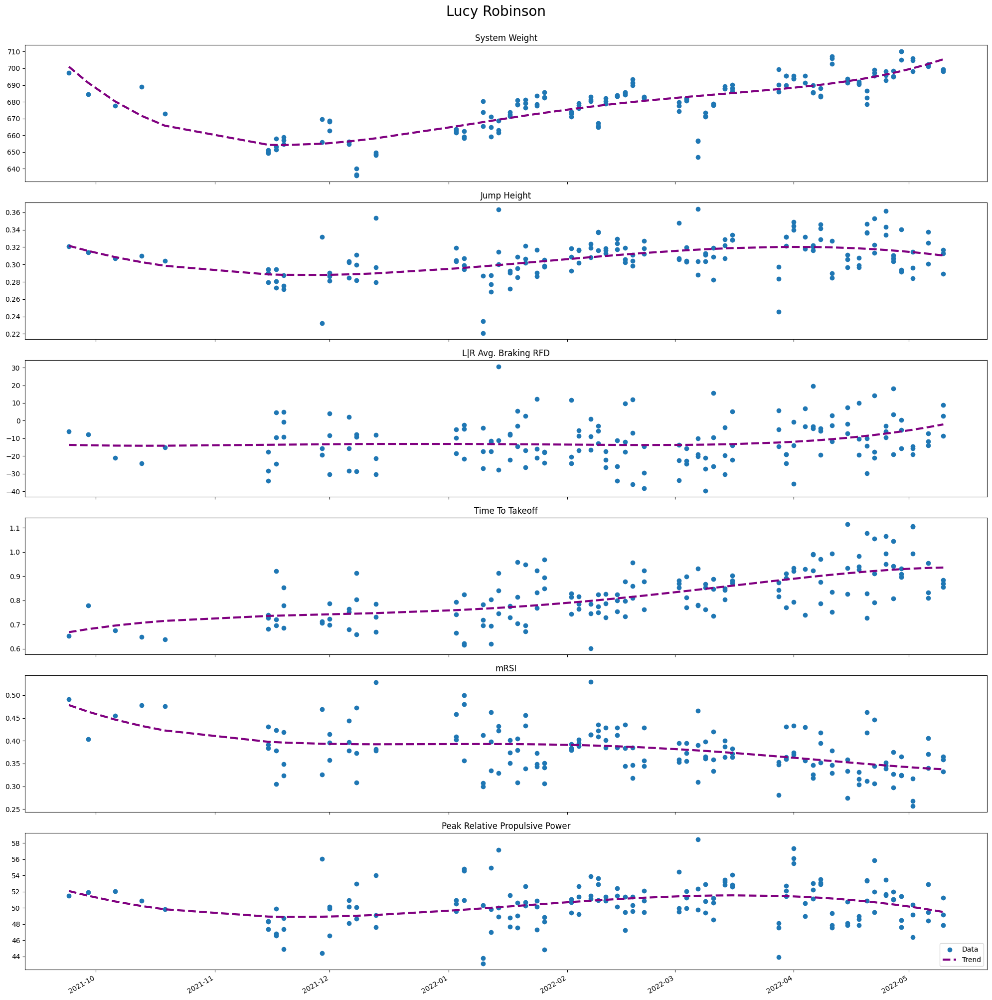

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


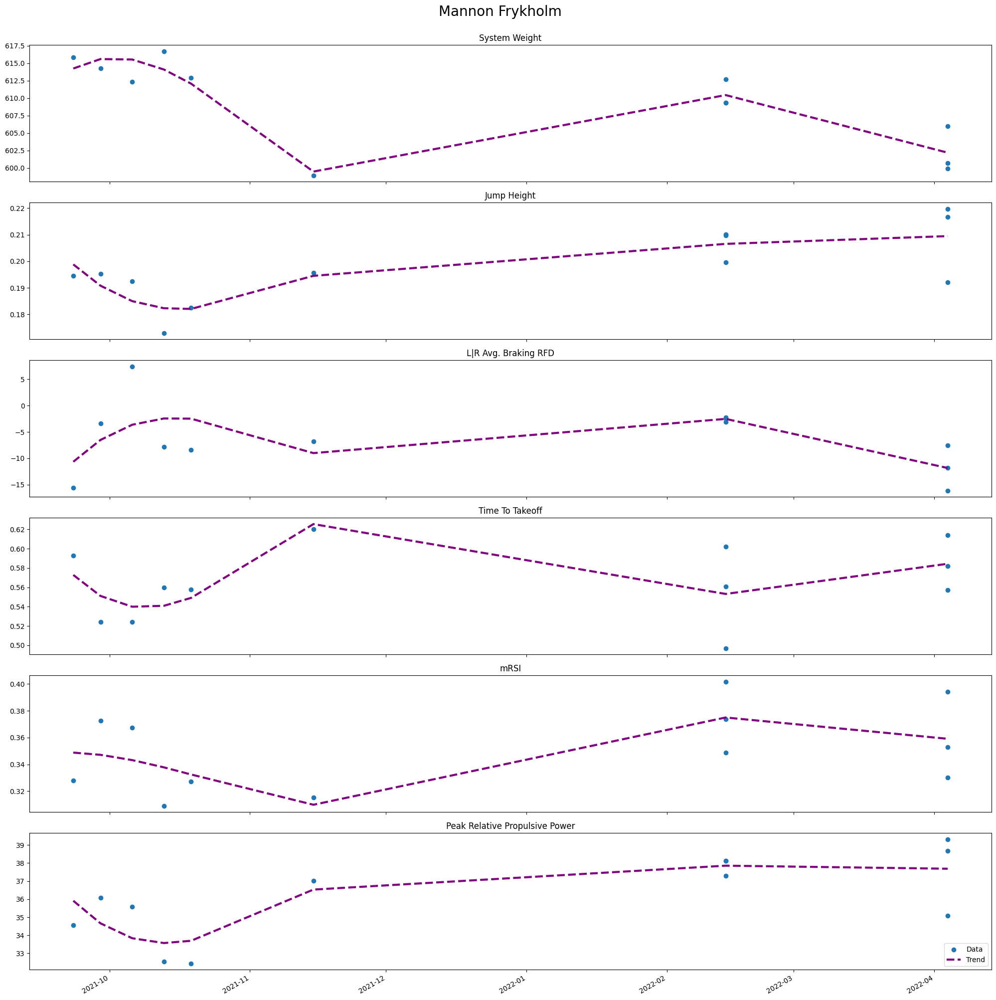

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


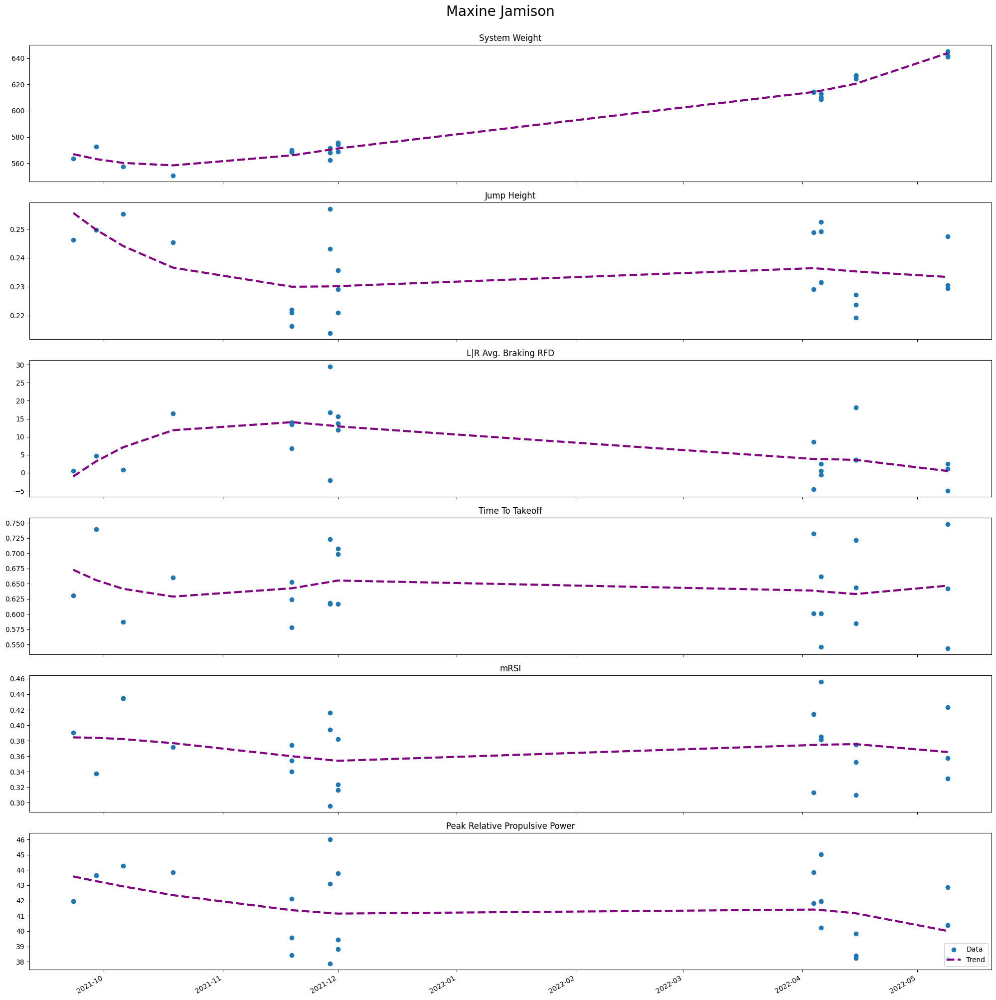

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


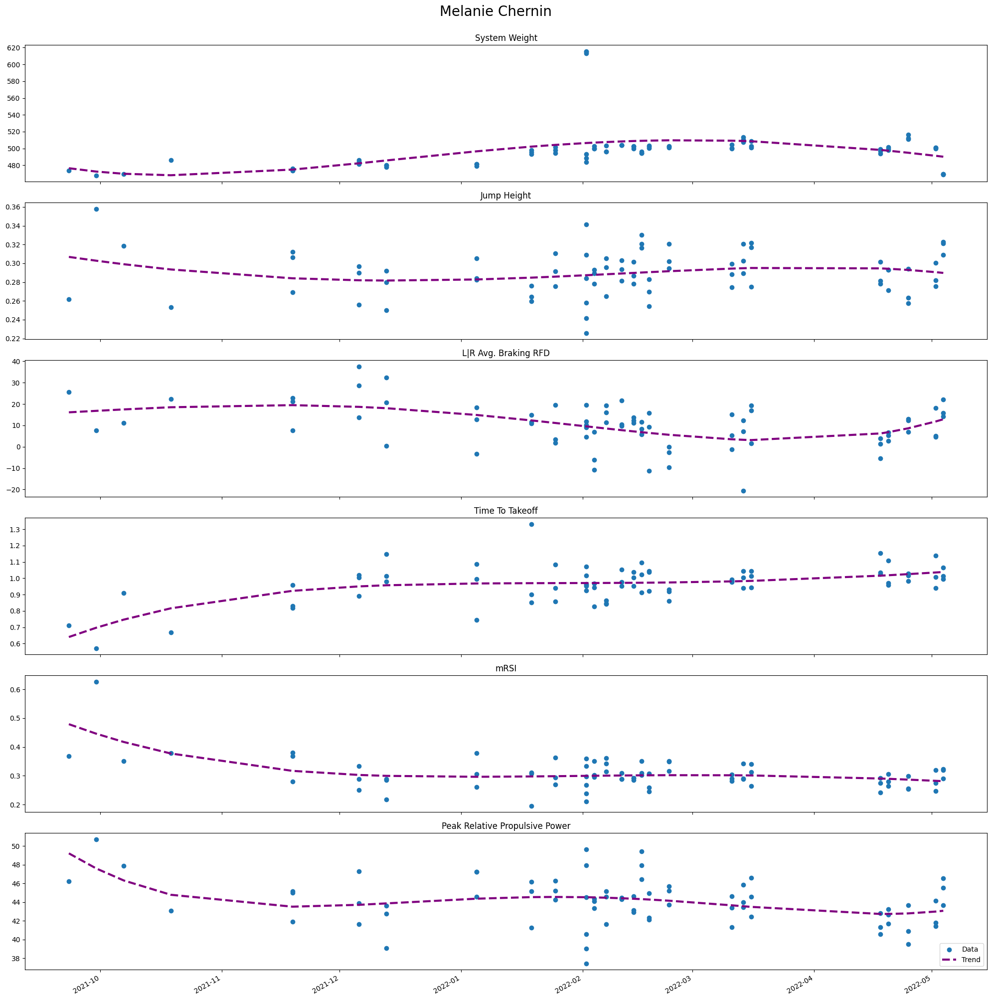

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


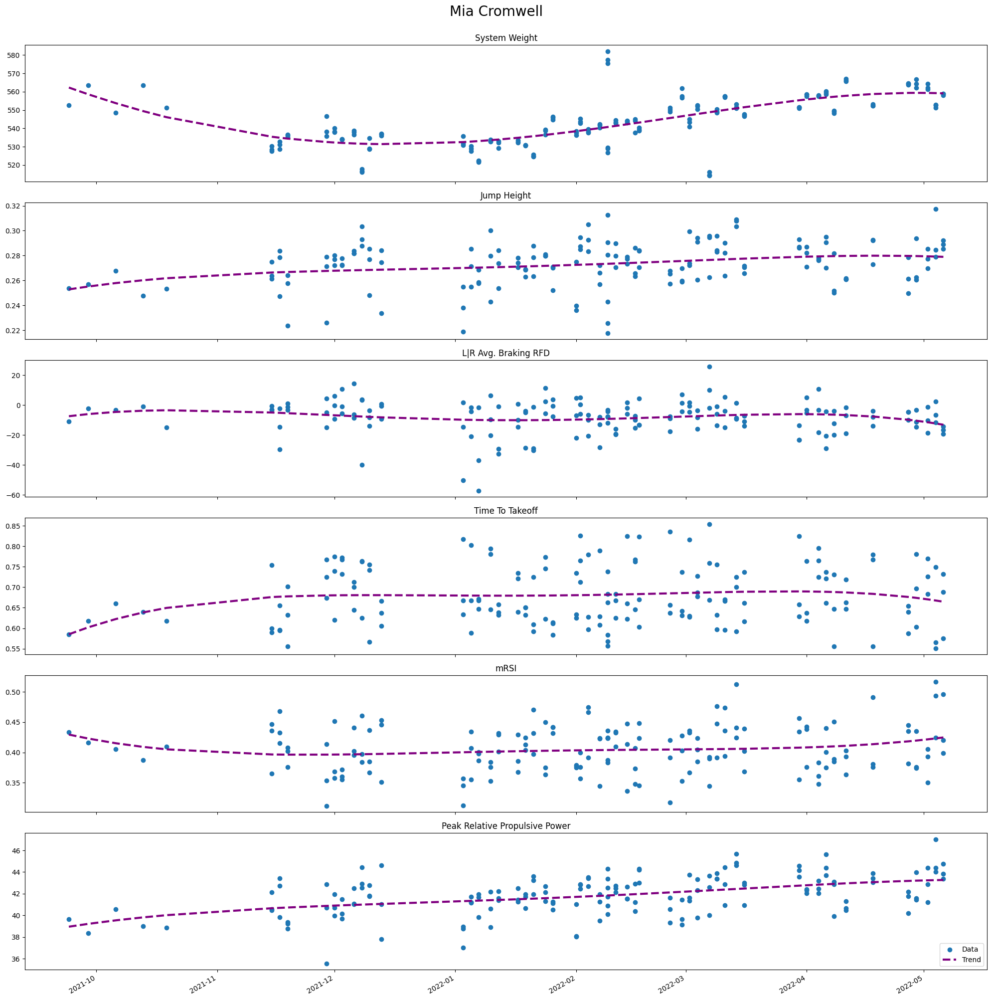

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


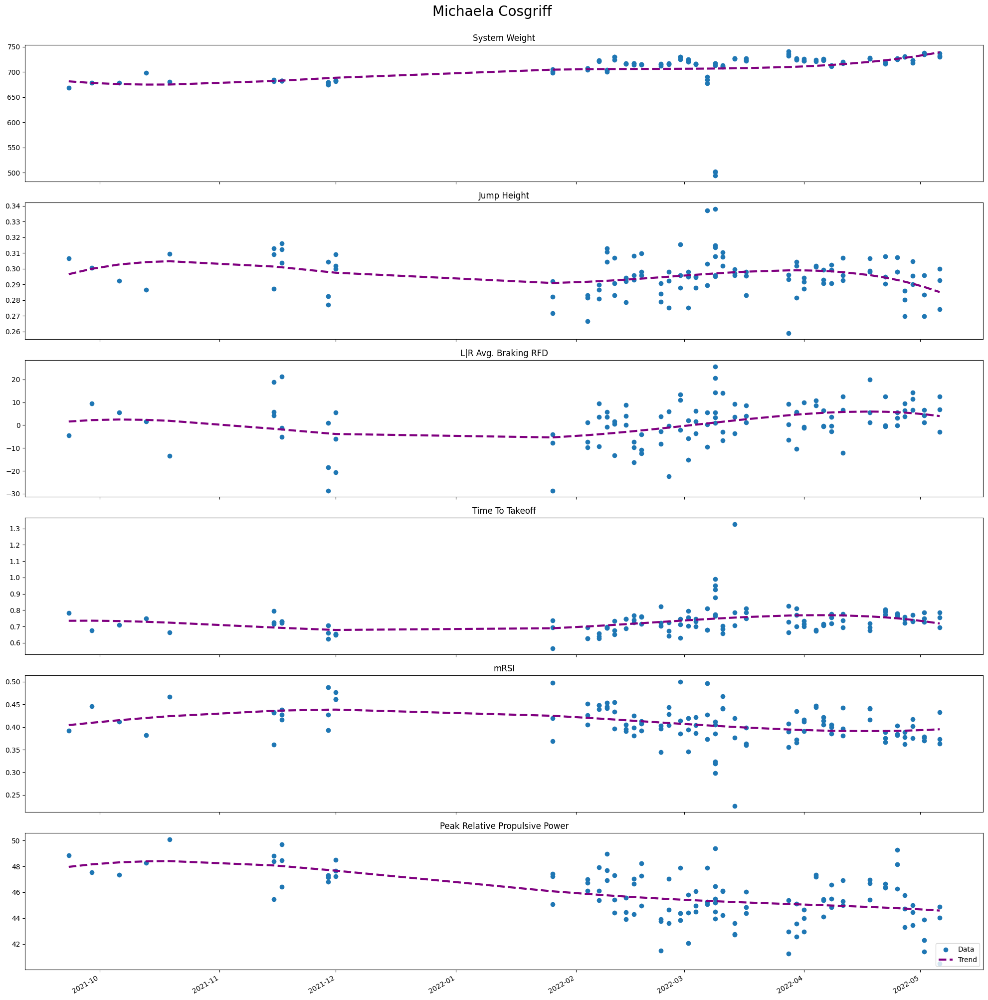

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


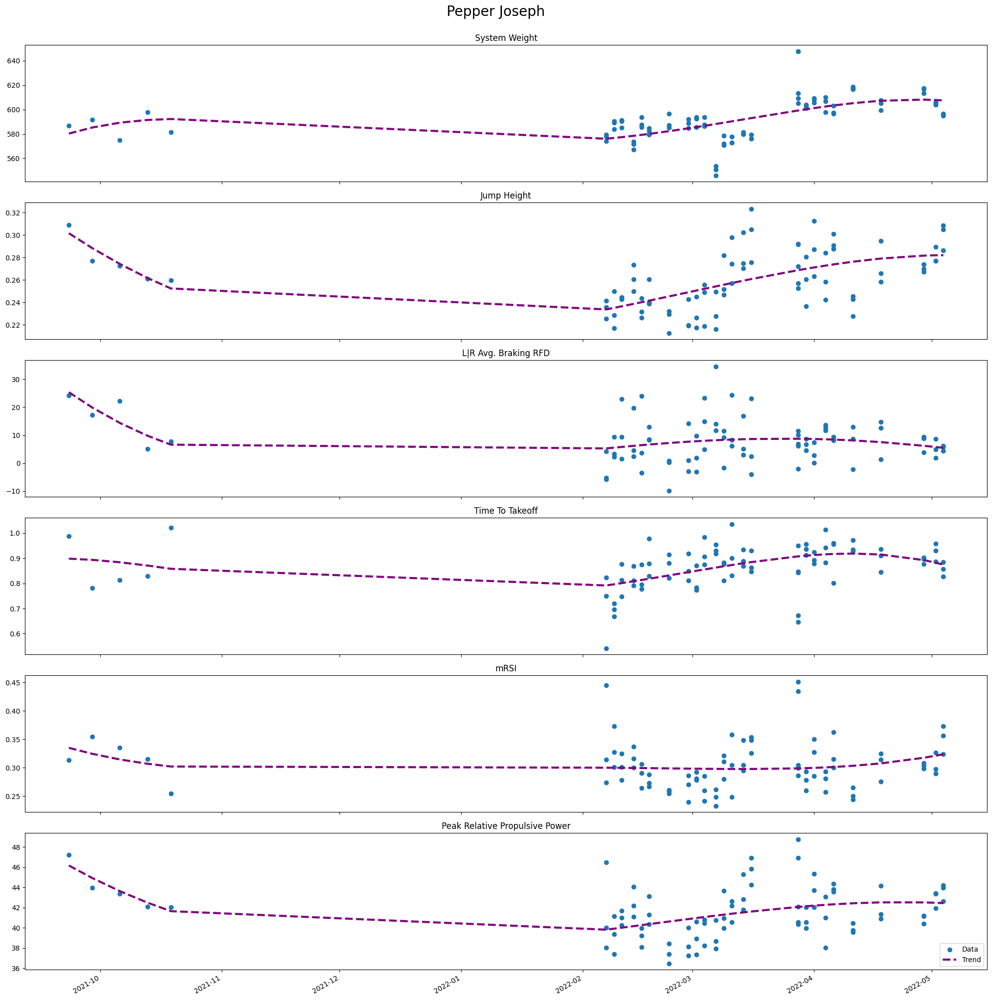

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


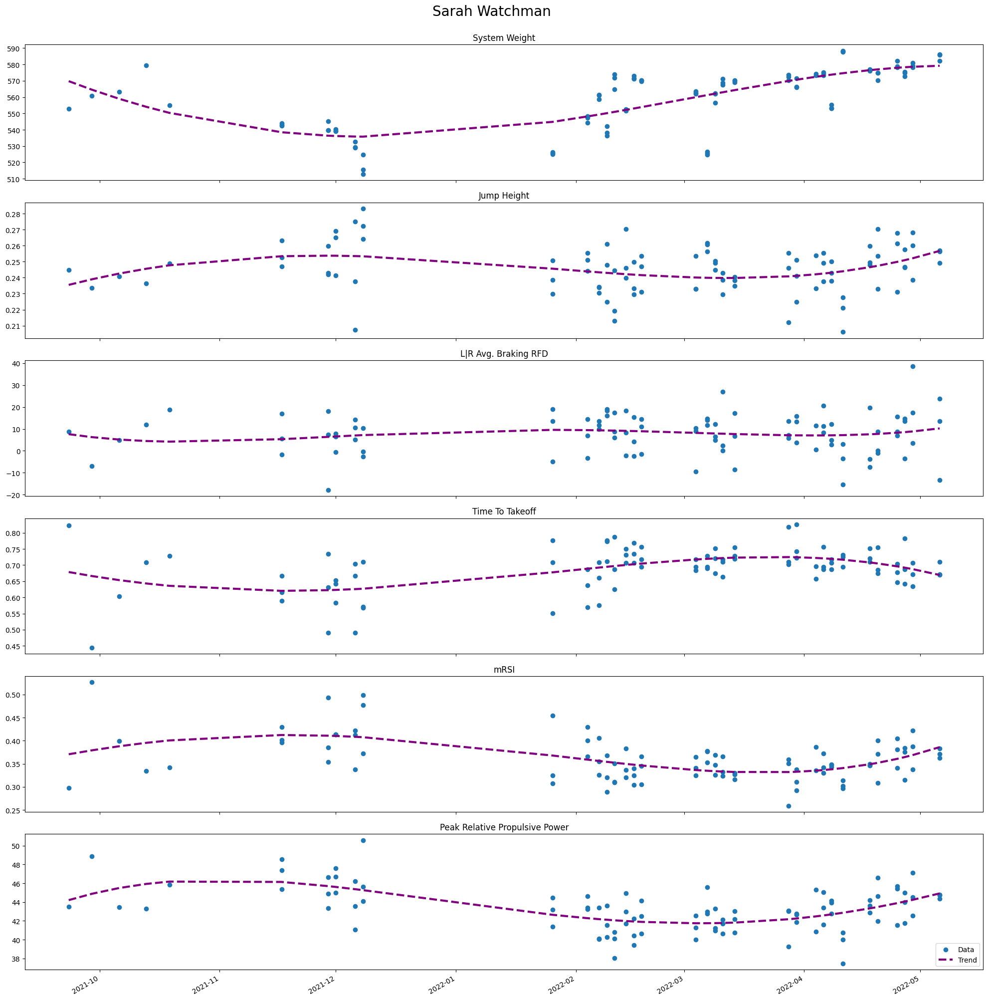

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


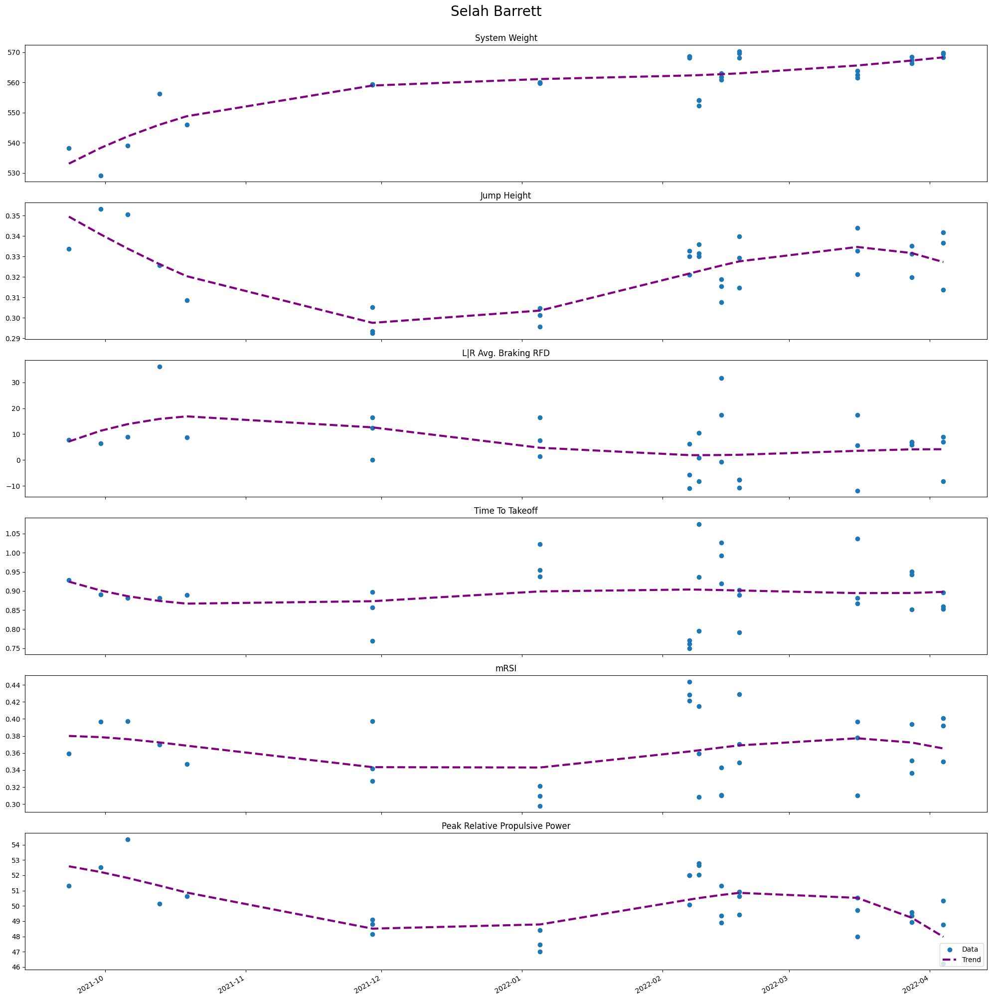

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


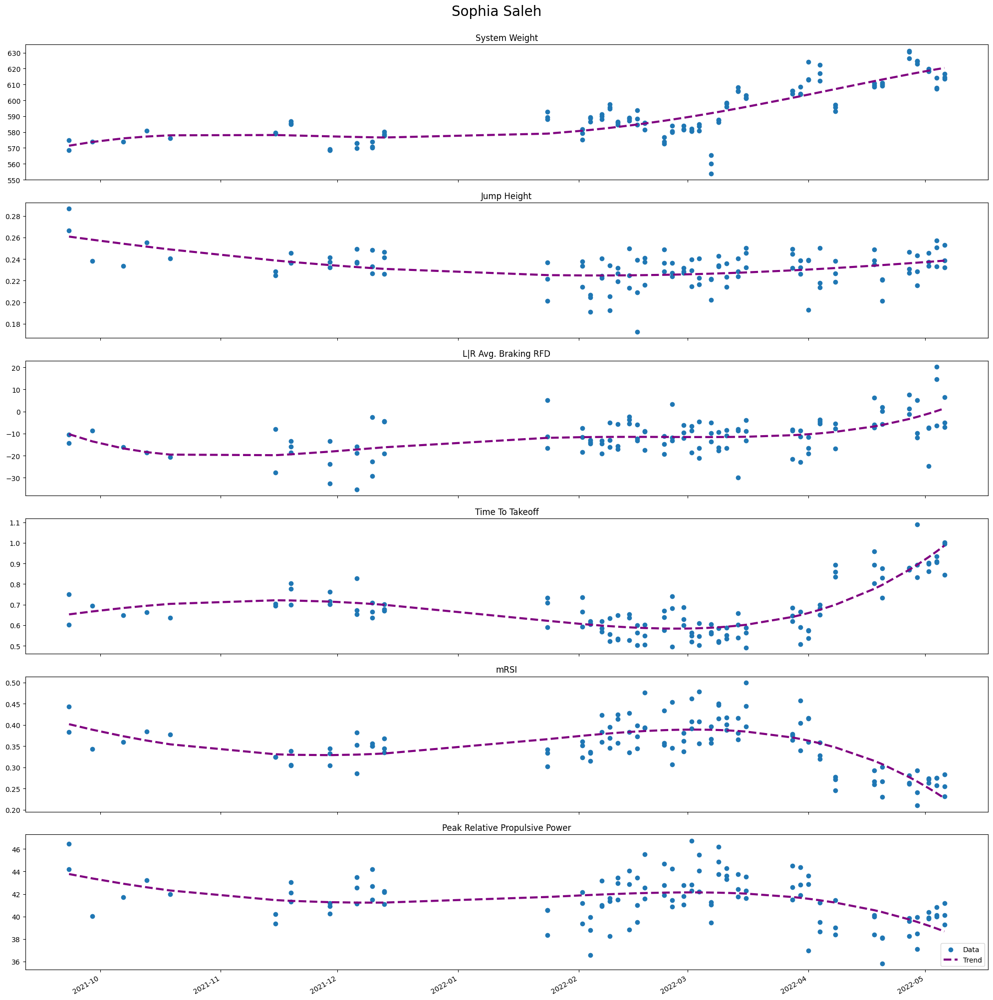

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


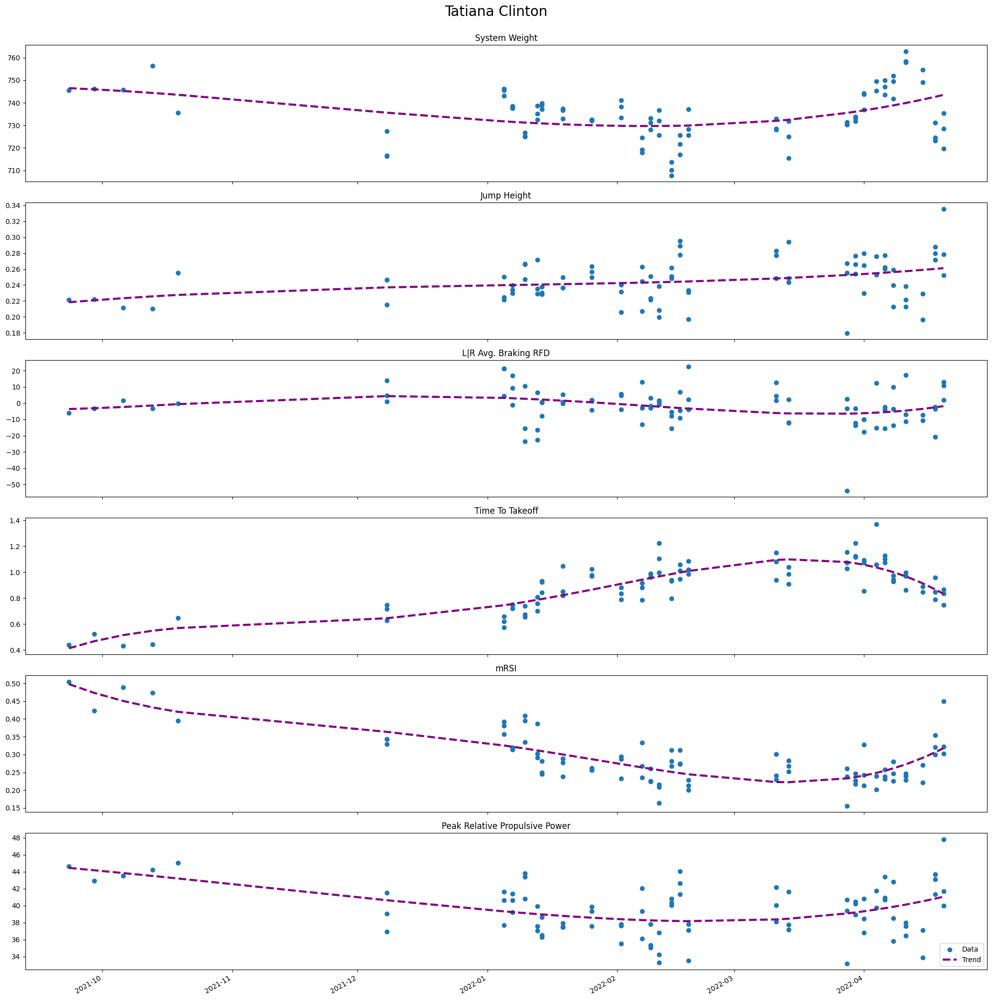

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:323: RankWarning: Polyfit may be poorly conditioned
  self.varGraphs(ds,name)


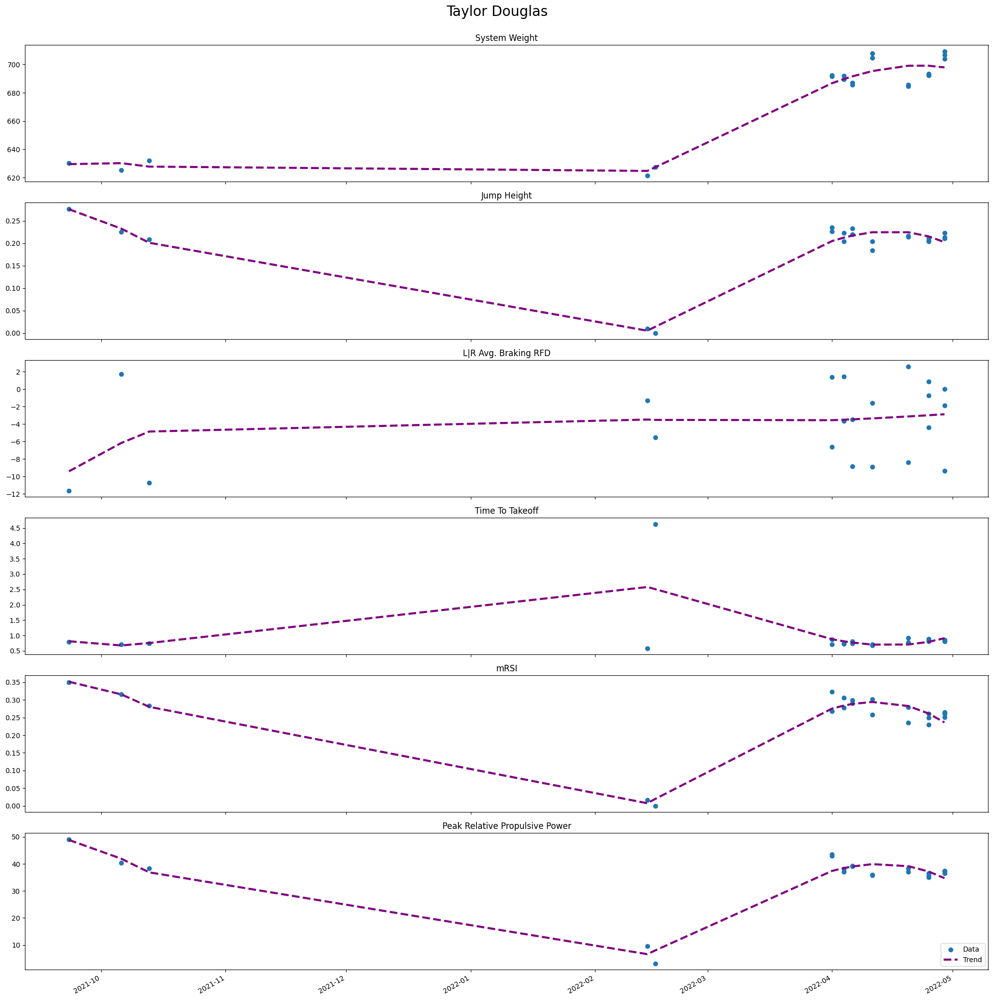

In [ ]:
aObj.springGraphsIndAll()

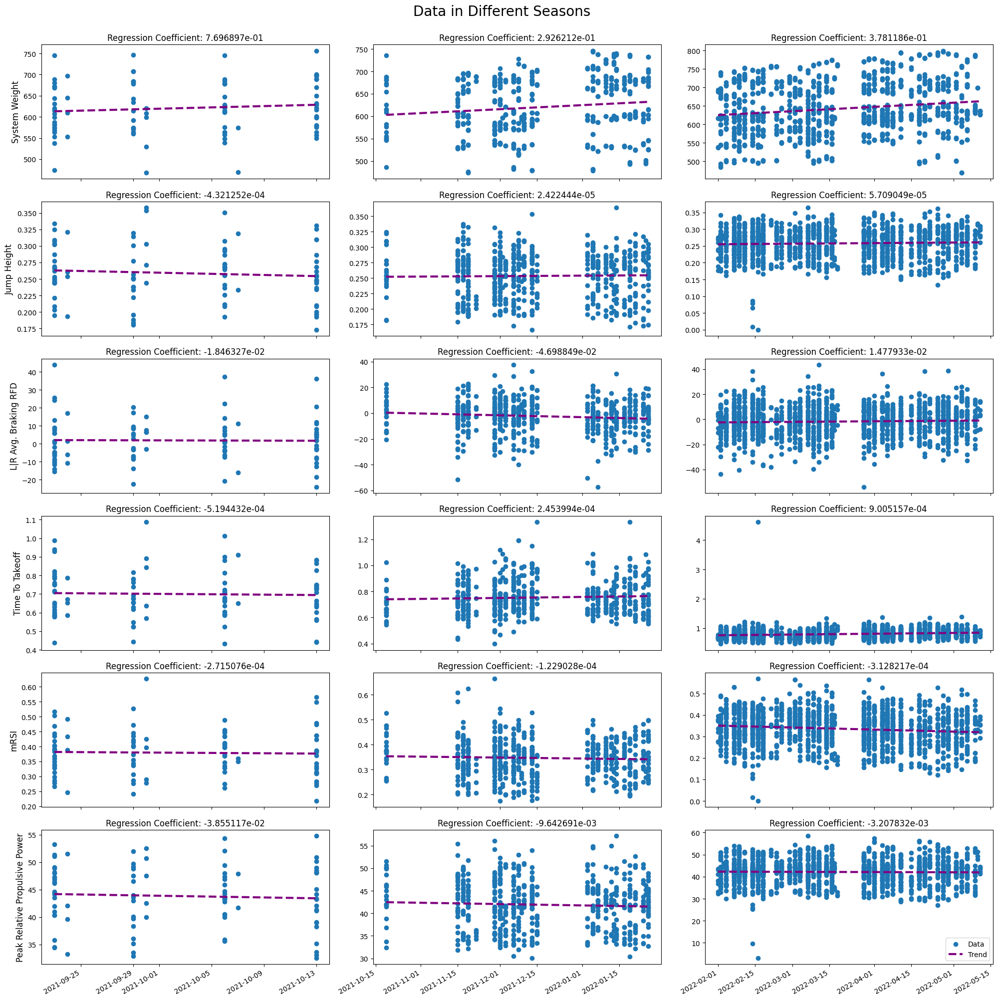

In [ ]:
aObj.teamGraphsBySeason()

/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:216: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  self.mean = self.fData.mean()
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:216: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  self.mean = self.fData.mean()
/Users/jonnasosauranga/Desktop/PEAK Performance/analysis.py:217: FutureWarning: The default value of numeric_only in DataFrame.std is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  self.std = self.fData.std()


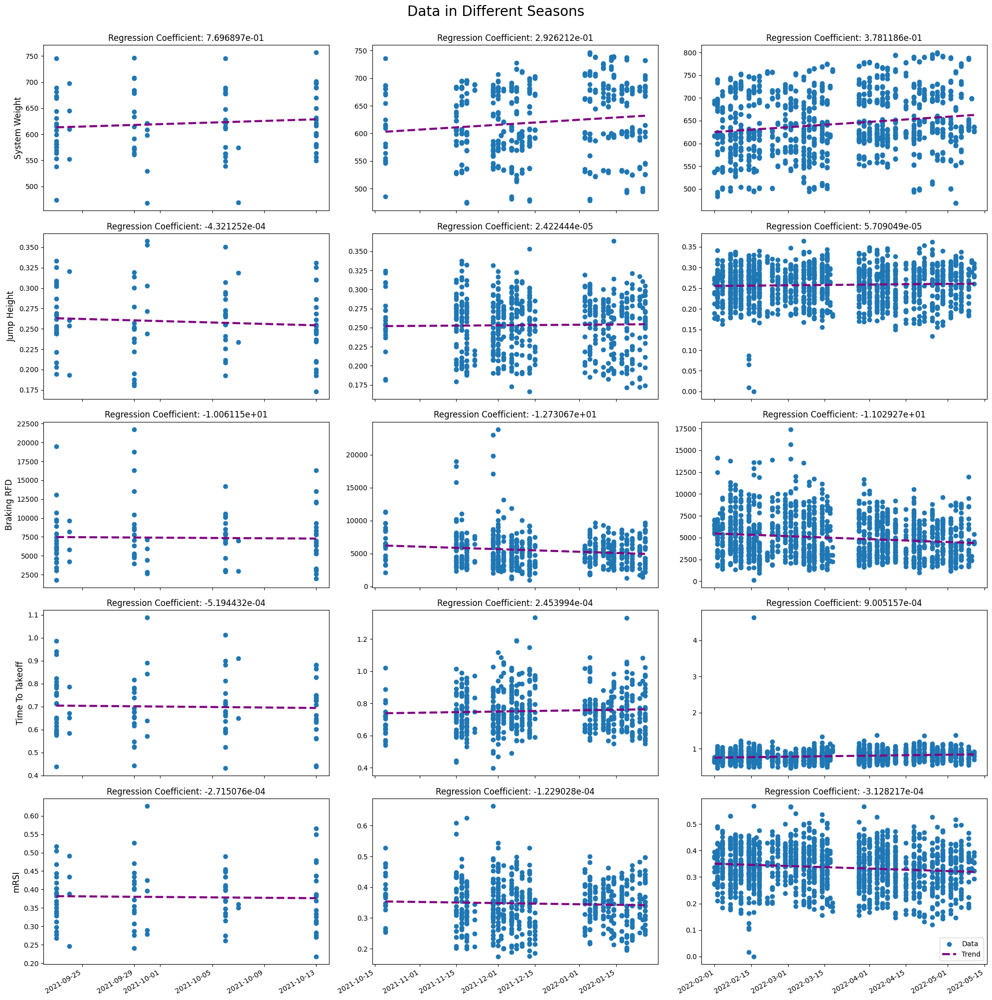

In [65]:
v = ['System Weight', 'Jump Height', 'Braking RFD','Time To Takeoff','mRSI']
volley = An('data/WS.csv',2021,fall='08/26',winter='10/15',spring='2/1',summer='05/26',variables=v)
volley.initialize()
volley.teamGraphsBySeason()

#volley.teamGraphsBySeason()

In [13]:
#test of getMean 
print("{:e}".format(volley.getMean("mRSI")))
print("{:e}".format(volley.getMeanFall("mRSI")))
print("{:e}".format(volley.getMeanWinter("mRSI")))
print("{:e}".format(volley.getMeanSpring("mRSI")))

#ds.describe()


3.407260e-01
3.792275e-01
3.462637e-01
3.360534e-01


In [15]:
#test of getCount 
print(volley.getCount("mRSI"))
print(volley.getCountFall("mRSI"))
print(volley.getCountWinter("mRSI"))
print(volley.getCountSpring("mRSI"))

2082
91
568
1423


In [16]:
#test of std 
print(volley.getStd("mRSI"))
print(volley.getStdFall("mRSI"))
print(volley.getStdWinter("mRSI"))
print(volley.getStdSpring("mRSI"))

0.07922679719433341
0.07847131261512645
0.07649816740997935
0.079584683029047


In [17]:
#test of min
print(volley.getMin("mRSI"))
print(volley.getMinFall("mRSI"))
print(volley.getMinWinter("mRSI"))
print(volley.getMinSpring("mRSI"))

0.0
0.2177
0.1744
0.0


In [18]:
#test of max
print(volley.getMax("mRSI"))
print(volley.getMaxFall("mRSI"))
print(volley.getMaxWinter("mRSI"))
print(volley.getMaxSpring("mRSI"))

0.6636
0.6266
0.6636
0.5677


In [19]:
#test of 25 quartile
print(volley.get25Q("mRSI"))
print(volley.get25QFall("mRSI"))
print(volley.get25QWinter("mRSI"))
print(volley.get25QSpring("mRSI"))

0.288325
0.3208
0.294875
0.28359999999999996


In [20]:
#test of 50 quartile
print(volley.get50Q("mRSI"))
print(volley.get50QFall("mRSI"))
print(volley.get50QWinter("mRSI"))
print(volley.get50QSpring("mRSI"))

0.34555
0.3828
0.34704999999999997
0.3429


In [22]:
#test of 75 quartile
print(volley.get75Q("mRSI"))
print(volley.get75QFall("mRSI"))
print(volley.get75QWinter("mRSI"))
print(volley.get75QSpring("mRSI"))

0.397
0.43374999999999997
0.3989
0.3941


In [26]:
#test of standard Error of measurement
print(volley.getSem("mRSI"))
print(volley.getSemFall("mRSI"))
print(volley.getSemWinter("mRSI"))
print(volley.getSemSpring("mRSI"))

0.001736327873136787
0.008226028713210244
0.003209791801715699
0.0021097307886519556


In [72]:
#test group by week graph
df = volley.fData

#convert date column to datetime and subtract one week
df['Date-week'] = df['Date'] - pd.to_timedelta(7, unit='d')

#calculate sum of values, grouped by week
week = df.groupby([pd.Grouper(key='Date-week', freq='W')])

for name, group in grpAthlete:
    print(name)
    print(group.describe())
    print()



/var/folders/6r/6kwn1zm53m107ycbq5f_9wm40000gn/T/ipykernel_42601/1831001200.py:10: FutureWarning: In a future version of pandas, a length 1 tuple will be returned when iterating over a groupby with a grouper equal to a list of length 1. Don't supply a list with a single grouper to avoid this warning.
  for name, group in week:


2021-09-19 00:00:00
       System Weight  Jump Height   Braking RFD  Time To Takeoff       mRSI
count      27.000000    27.000000     27.000000        27.000000  27.000000
mean      613.305793     0.262748   6995.704500         0.709815   0.378719
std        58.843702     0.039200   3593.924383         0.127447   0.072459
min       473.564600     0.193200   1804.081600         0.439000   0.245800
25%       574.801300     0.244350   4625.718300         0.608000   0.331550
50%       609.421400     0.260500   6106.870200         0.712000   0.387300
75%       656.603600     0.294550   8577.731100         0.789000   0.426150
max       745.492500     0.333700  19476.190500         0.987000   0.516500

2021-09-26 00:00:00
       System Weight  Jump Height   Braking RFD  Time To Takeoff       mRSI
count      21.000000    21.000000     21.000000        21.000000  21.000000
mean      620.876786     0.258490   8343.177095         0.692952   0.383548
std        68.365830     0.051874   5195.473833